In [16]:
#/usr/bin/env python
import numpy as np
import pylab as pl
import subprocess as sp
#import source_redshift_dist as srd
import healpy as hp
from astropy import units as u
from astropy.cosmology import FlatLambdaCDM
from astropy.cosmology import z_at_value
import input
import os
from scipy.integrate import quad
from scipy.interpolate import interp1d
import healsparse
import random
import h5py

H0 = 71.0
Om0=0.2648
Ob0=0.044792699861138666
ncosmo = FlatLambdaCDM(H0=H0, Om0=Om0, Ob0=Ob0)

rho_crit = ncosmo.critical_density0.to(u.solMass/u.Mpc/u.Mpc/u.Mpc).value/ncosmo.h/ncosmo.h #M_sun Mpc^-3 *h*h
vc = 2.998e5 #km/s
G = 4.3011790220362e-09 # Mpc/h (Msun/h)^-1 (km/s)^2
mp      = 2.602746*10**9*ncosmo.h                                   # in Msun/h

#From Cyrille: 2602746430.321433

# DMO or baryons"?
dmo=False

########################### Mass Maps ################################
path_out = 'IA-infusion/BCM/kappa/'
path_in = '/pscratch/sd/a/avijit97/BCM/HACC/nshells_51/'
directory_contents = os.listdir(path_in)




In [17]:
def total_area(x_in,y_in):
    x_down = x_in[:-1]
    x_up = x_in[1:]
    y_down = y_in[:-1]
    y_up = y_in[1:]

    area_array = (y_down+y_up)*(x_up-x_down)/2.0

    return np.sum(area_array)


def cal_pdz(fname, z_in,col):

    #zs,dist1 = np.loadtxt("./data/source_distribution.txt",comments='#',usecols=(0,1),unpack=True)
    zs,dist1 = np.loadtxt(fname,comments='#',usecols=(0,col),unpack=True)
    dist1_normal = dist1/total_area(zs,dist1)
    # dist1_normal = dist1

    #np.savetxt("./data/srd_normed.dat",np.transpose(np.array([zs,dist1_normal])),fmt="%.6e")

    # f1 = interp1d(zs[::-1], dist1_normal[::-1], kind='cubic',bounds_error=False, fill_value=0.0)
    f1 = interp1d(zs[::-1], dist1_normal[::-1], kind='linear',bounds_error=False, fill_value=0.0)
    #f1 = interp1d(zs, dist1_normal, kind='linear',fill_value="extrapolate")

    return f1(z_in)

def wfunc_all(fname, zl,col):
    
    if(zl==0):
        zl=0.0001
        print("set minimal zl to 0.0001")
    Dc_l = ncosmo.comoving_distance(zl).value*ncosmo.h
    cfactor = 4.0*np.pi*G/vc**2*(1.0+zl)/Dc_l


    zs_list = np.linspace(0.001,4.0,1000)
    #zs_list = np.logspace(-3,0.6,100)
    dzs = zs_list[1]-zs_list[0]
    total_wfunc = 0.0

    for zs in zs_list:
        if (zs<zl):
            continue

        Dc_s = ncosmo.comoving_distance(zs).value*ncosmo.h
        Dc_ls = Dc_s - Dc_l

        tmp = dzs*cal_pdz(fname, zs,col)*Dc_ls/Dc_s
        total_wfunc = total_wfunc + tmp

    #res = cfactor/afactor*total_wfunc
    res = cfactor*total_wfunc

    return res

def kappa_sl_ss(filename,zl,zs, dmo):

    if(zl==0):
        zl=0.005
        print("set minimal zl to 0.005")

    Dc_l = ncosmo.comoving_distance(zl).value*ncosmo.h
    Dc_s = ncosmo.comoving_distance(zs).value*ncosmo.h
    Dc_ls = Dc_s - Dc_l

    #nside_c = 32
    #a = healsparse.HealSparseMap.read(os.path.join(path, filename))
    #sdens = a.generate_healpix_map()
    with h5py.File(filename,'r') as f:
        #print('h5py file fields:',f.keys())
        nobaryon_shells = np.array(f['nobaryon_shells'])
        diff_shells = np.array(f['diff_shells'])
        #baryon_shells = nobaryon_shells+diff_shells
    
    if(dmo):
        sdens=nobaryon_shells
    else:
        sdens=nobaryon_shells+diff_shells 
    
    # turn masked pixels to zero.
    #sdens[sdens<-1.0e+30]=0

    #Map already in ring format:

    
    
    
    sdens_arc = sdens#/np.deg2rad(1.0)**2.0#*3.0462e-4 # 1 degree^2 = 3.0462e-4 steradian
    sdens_arc*=mp
    sdens_arc_normal = (sdens_arc-sdens_arc.mean()*8.0) # factor of 8.0 corrects for mean computed over all 8 octants

    #Normalisation:
    Norm = 1.6125e+07

    
    #-----------------------
    # Results 2
    cfactor = 4.0*np.pi*G/vc**2
    res = cfactor*(1.0+zl)/Dc_l*Dc_ls/Dc_s*sdens_arc_normal*Norm
    #print('Kernel = ', zl, zs, cfactor*(1.0+zl)/Dc_l*Dc_ls/Dc_s)
    return res

def kappa_sl_ms(filename,fname,zl,col):

    nside_c = 32    
    a = healsparse.HealSparseMap.read(os.path.join(path, filename))
    sdens = a.generate_healpix_map()
    
    # turn masked pixels to zero.
    sdens[sdens<-1.0e+30]=0
    #Map already in ring format:
    #hp.mollview(sdens,
    #            unit='kappa', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()
    
    
    
    sdens_arc = sdens#/np.deg2rad(1.0)**2.0#*3.0462e-4 # 1 degree^2 = 3.0462e-4 steradian
    sdens_arc*=mp
    sdens_arc_normal = (sdens_arc-sdens_arc.mean()*8.0) # factor of 8.0 corrects for mean computed over all 8 octants

    #Normalisation:
    Norm = 1.6125e+07
    
    res = wfunc_all(fname, zl,col)*sdens_arc_normal*Norm

    print(filename, zl, mp, wfunc_all(fname, zl,col))
    #hp.mollview(res,
    #            unit='kappa_z', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()

    return res



In [12]:
# Set redshift arrays:
#zfile=np.loadtxt("z2ts.txt",delimiter=',')
nshells=51 # update to 51 soon
seed=0
IC=150

zfile=np.loadtxt("z2ts_HACCY1_"+str(nshells)+".txt")
snaplist = zfile[0:nshells,0].astype(int)
zsnap=zfile[0:nshells,1]
print(snaplist[0:nshells])
#print(zsnap)
rds_lower = zfile[0:nshells,2]
rds_upper  = zfile[0:nshells,3]


   
#-----
# Get lens redshifts, either from geometry (Wrong, I miss the dNdz.):
zl_list = (3.0/4.0)*(rds_upper**4-rds_lower**4)/(rds_upper**3-rds_lower**3)
#... or from the partice distribution:
#tmp=np.loadtxt("z_or_skysim.txt")
zlens_exact=np.zeros_like(zsnap)
for plane in range(0,nshells):
    #zlens_exact[plane]=zsnap[nshells-1-plane]
    zlens_exact[plane]=zsnap[plane]
zlens_exact = zlens_exact[:nshells] 
    
print( " z_       z^               zl_geo             zl_file            "  )
for plane in range(0,nshells):
    print(rds_lower[plane], rds_upper[plane], zl_list[plane],zlens_exact[plane] )

#Mean_r = (r_max^4 - r_min^4)/(r_max^3 - rmin^3)*(3/4)
#zl_list = 0.5*(rds_lower+rds_upper)


#print(zlens_exact)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50]
 z_       z^               zl_geo             zl_file            
0.0 0.008024072216650024 0.0060180541624875175 0.0
0.008024072216650024 0.024464831804281273 0.01879958664574124 0.016177957532861553
0.024464831804281273 0.041450777202072686 0.034385256846666164 0.03288797533401855
0.041450777202072686 0.05900948366701808 0.051242803901123554 0.050156739811912265
0.05900948366701808 0.07717041800643099 0.06889250635538471 0.0680127523910734
0.07717041800643099 0.09596510359869148 0.0872451840692904 0.08648648648648649
0.09596510359869148 0.11542730299667059 0.10629179393422432 0.10561056105610578
0.11542730299667059 0.13559322033898313 0.12604911701405563 0.12541993281075037
0.13559322033898313 0.15650172612197943 0.14654550789679113 0.14595210946408232
0.15650172612197943 0.17819460726846414 0.16781617607874455 0.16724738675958184

set minimal zl to 0.005
Got lens 0.0
Mask already defined!


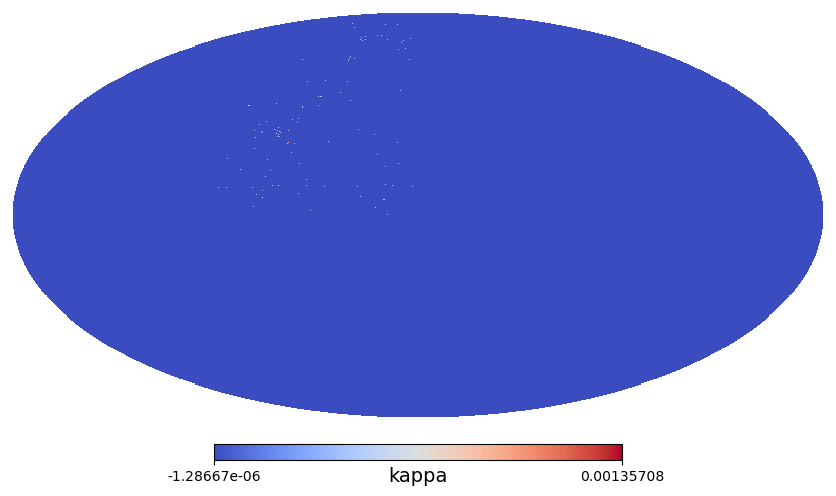

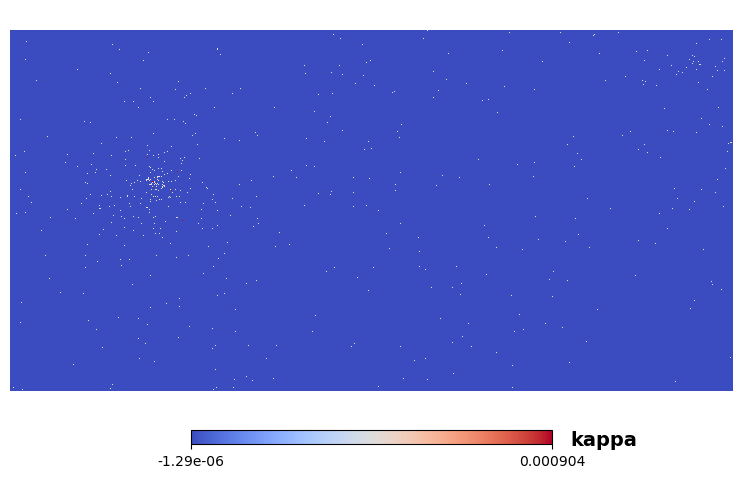

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Mask already defined!


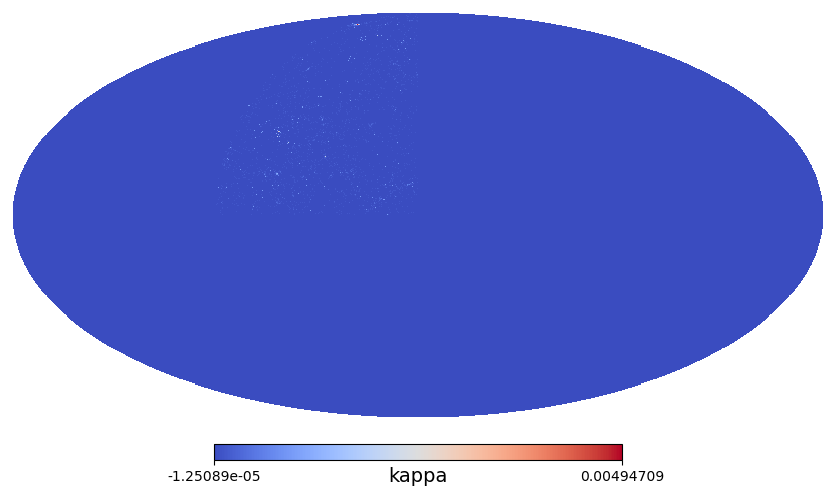

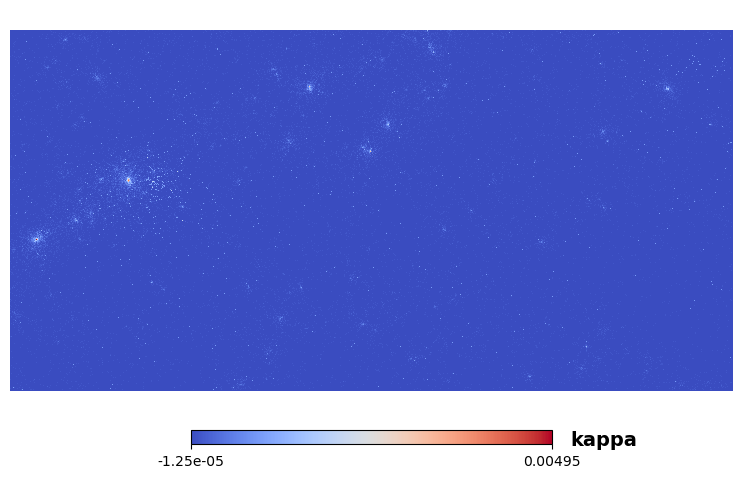

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Mask already defined!


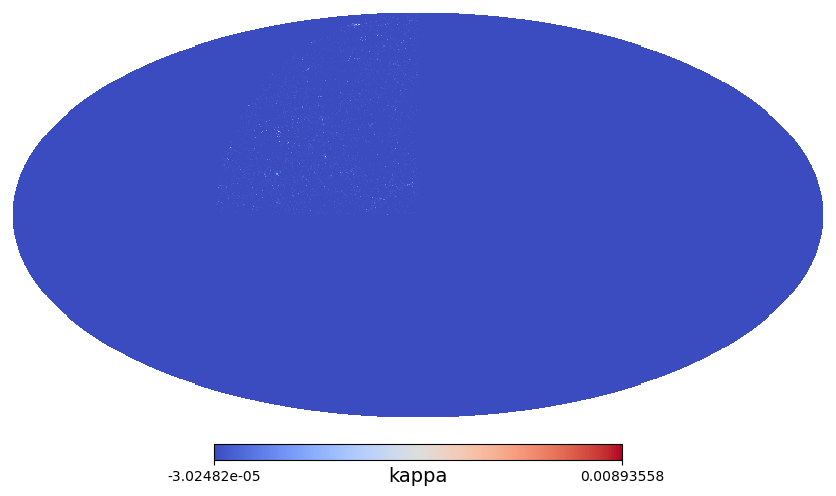

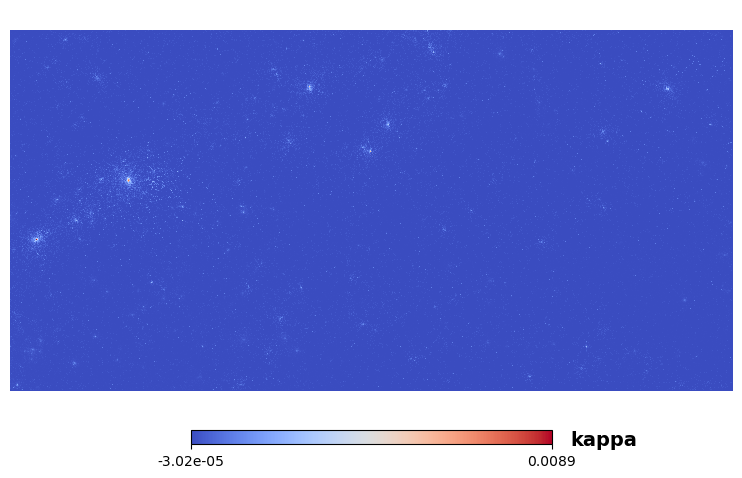

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Mask already defined!


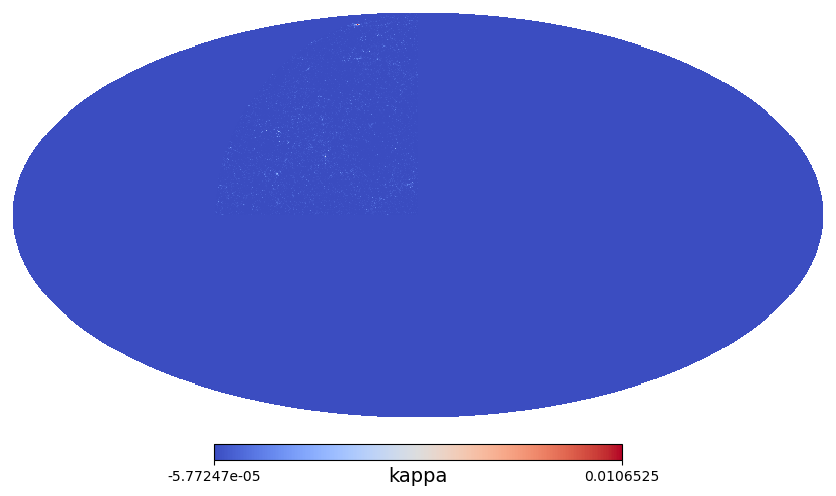

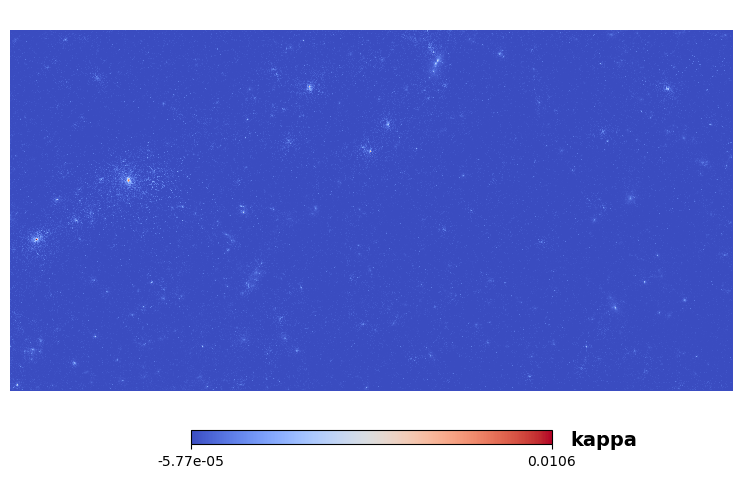

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Mask already defined!


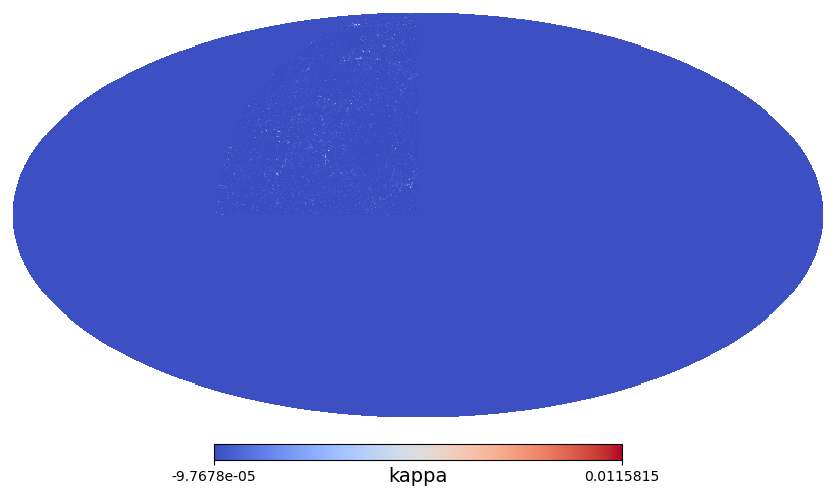

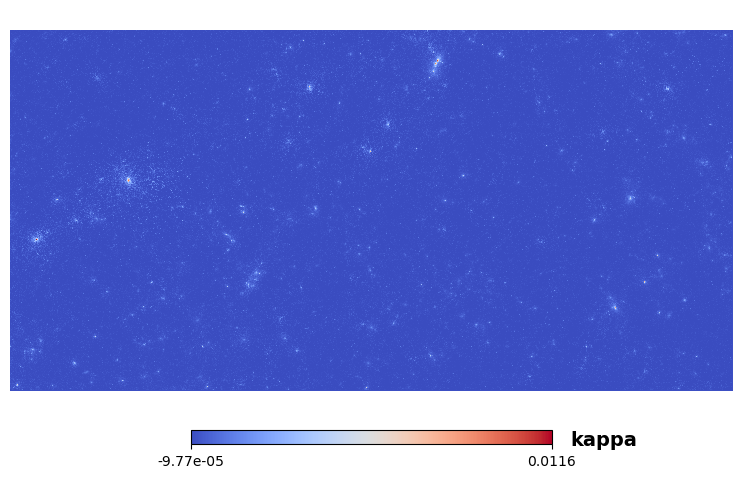

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Mask already defined!


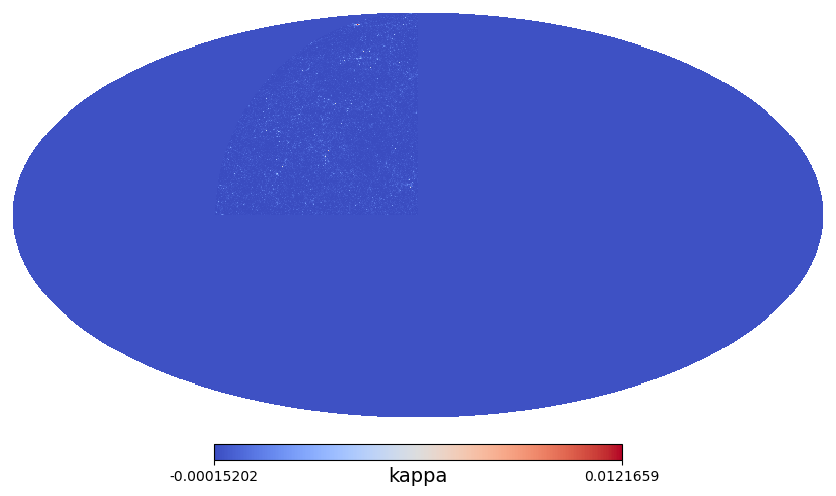

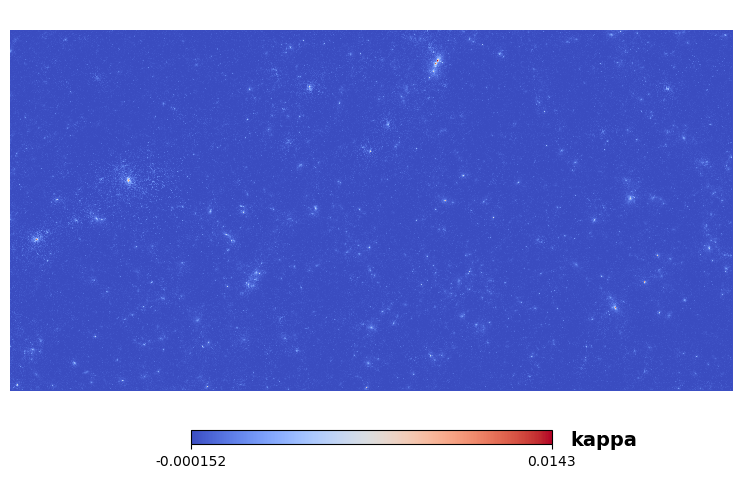

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Mask already defined!


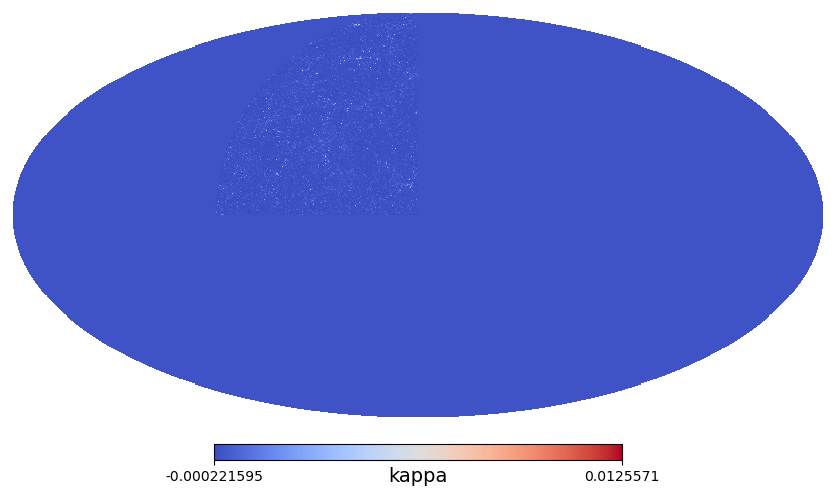

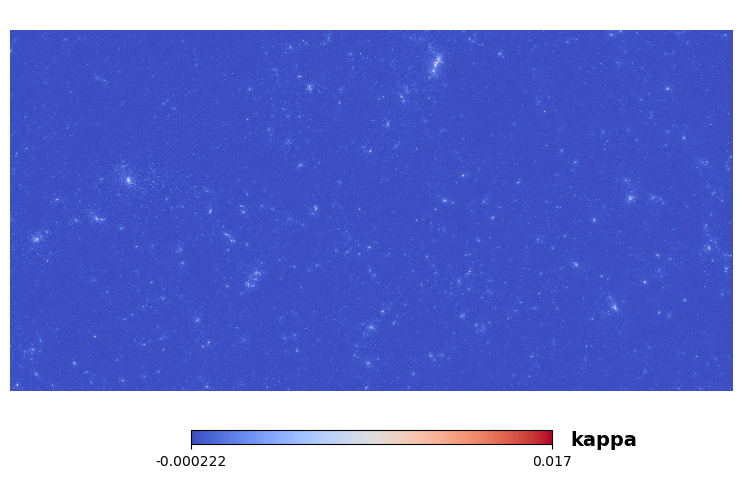

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Mask already defined!


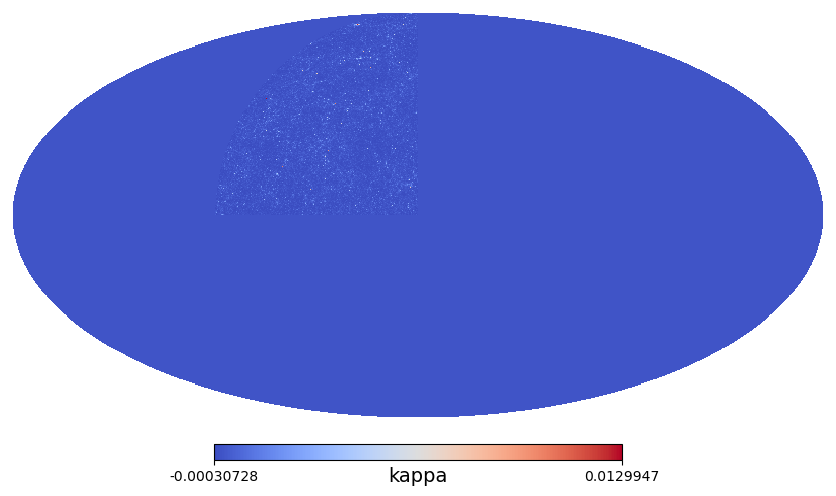

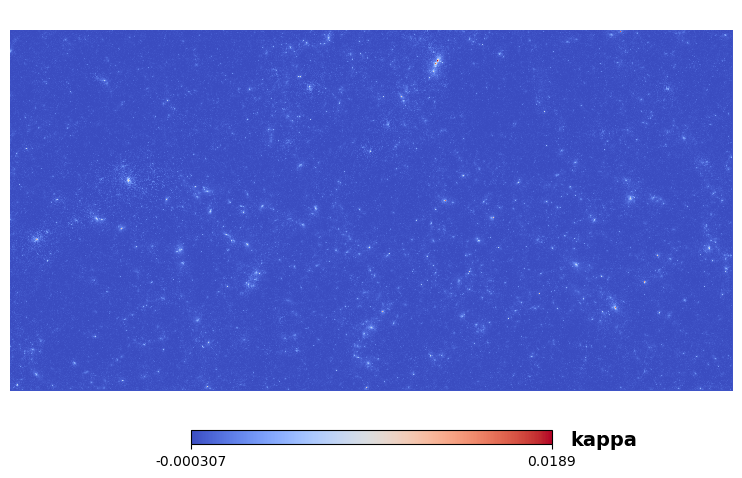

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Mask already defined!


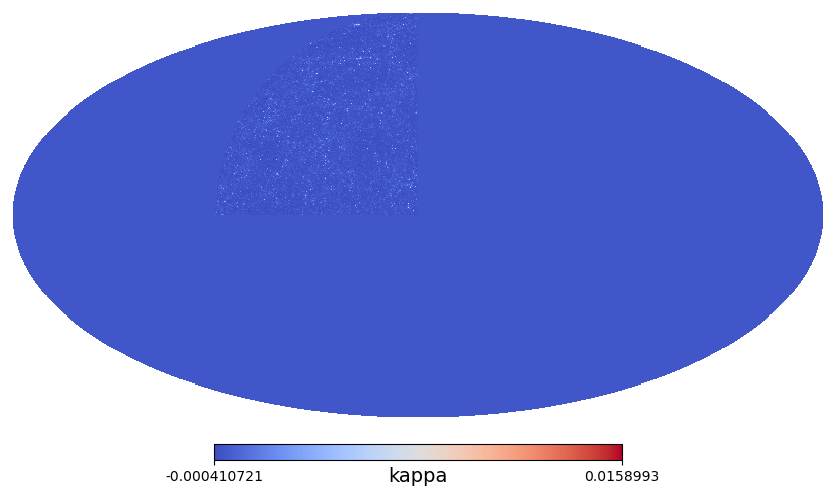

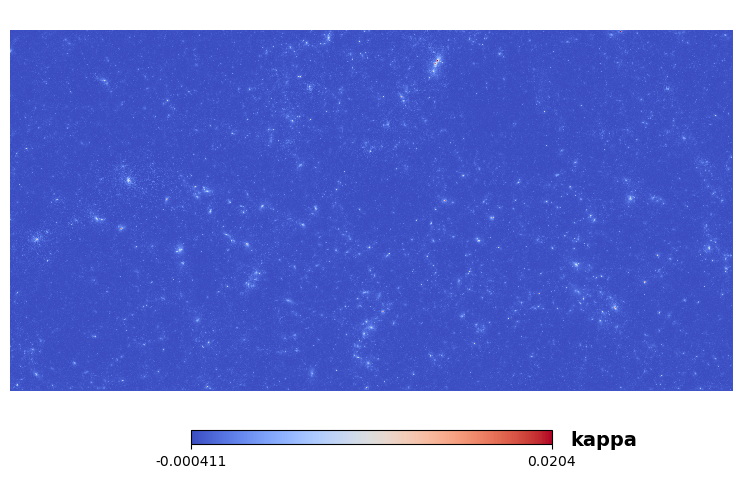

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Mask already defined!


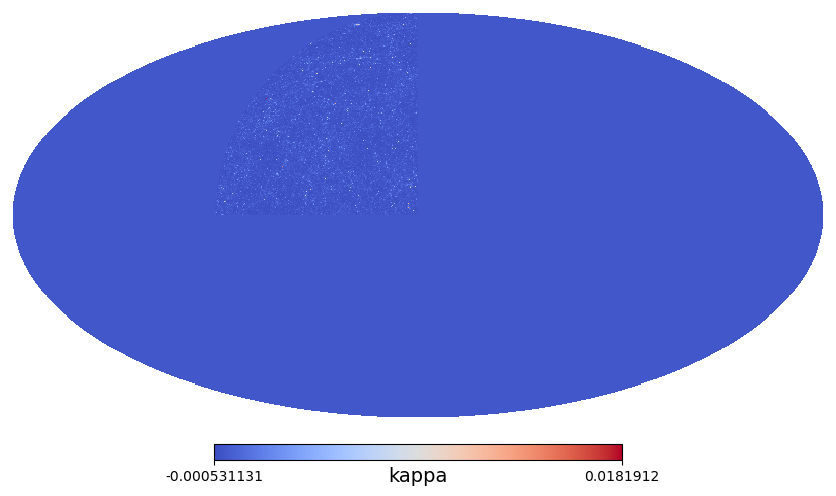

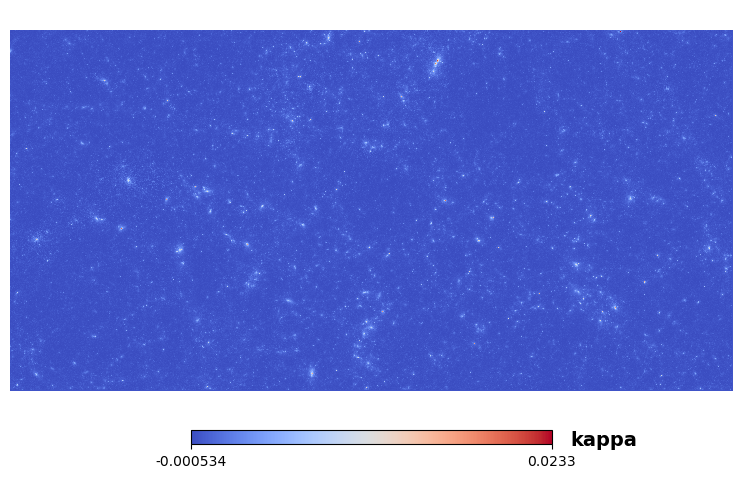

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Mask already defined!


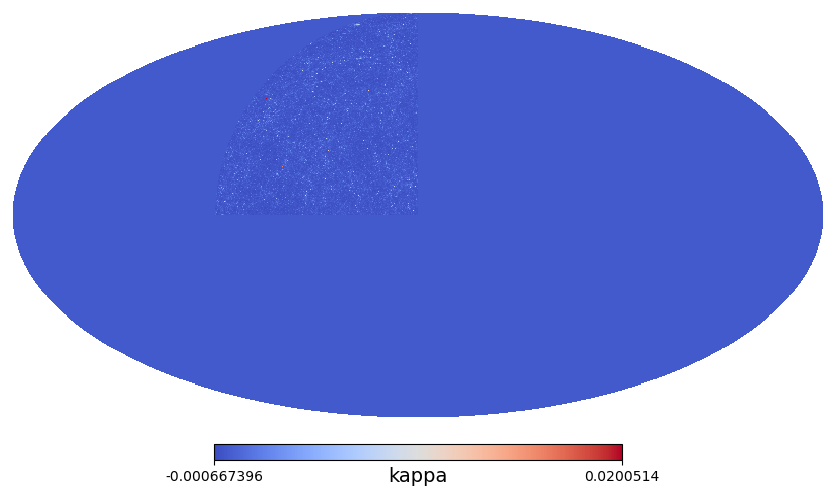

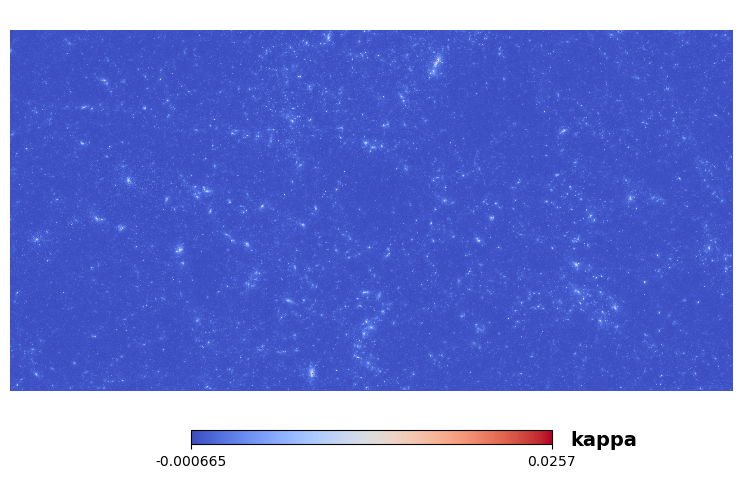

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Mask already defined!


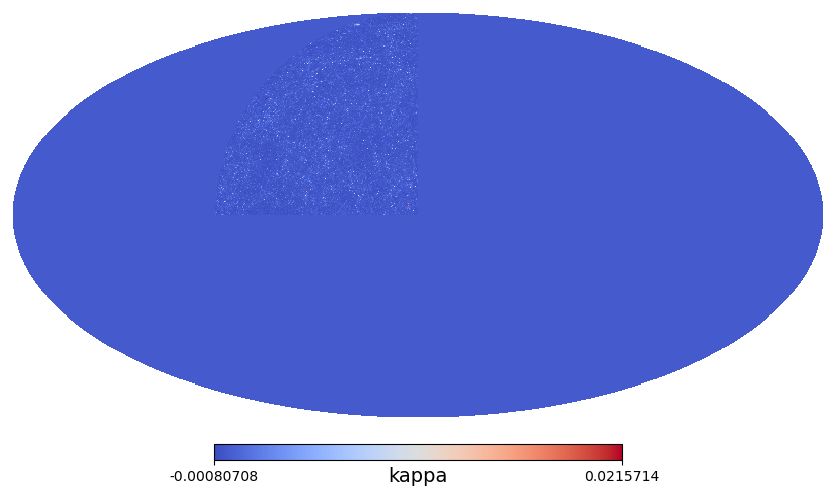

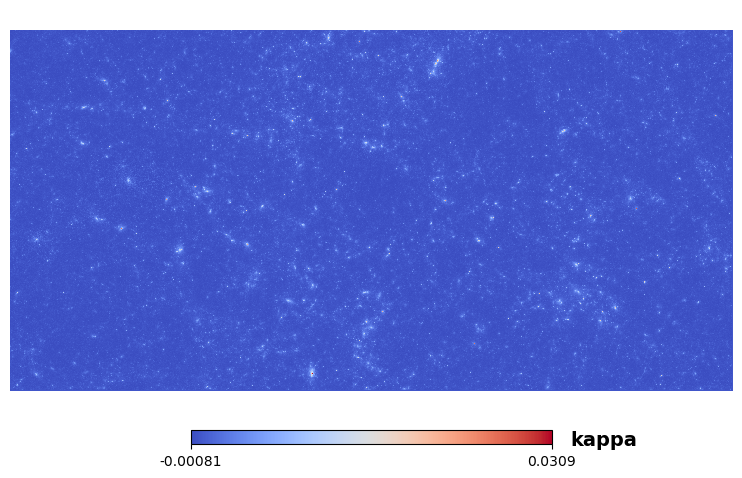

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Mask already defined!


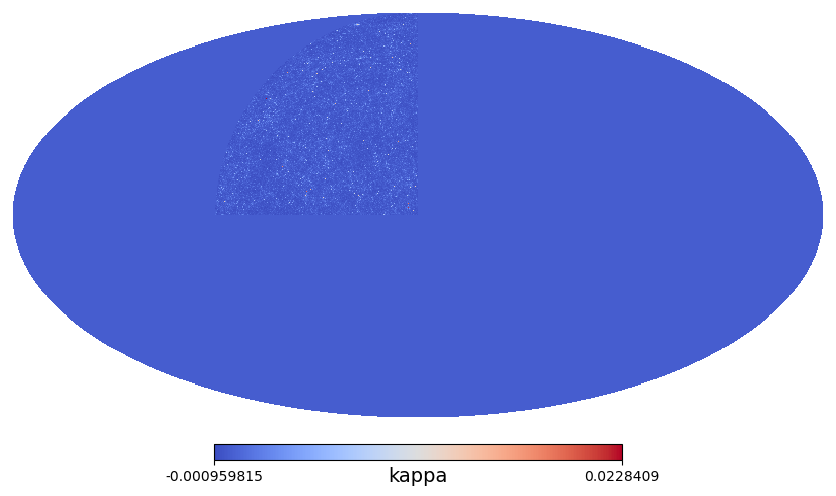

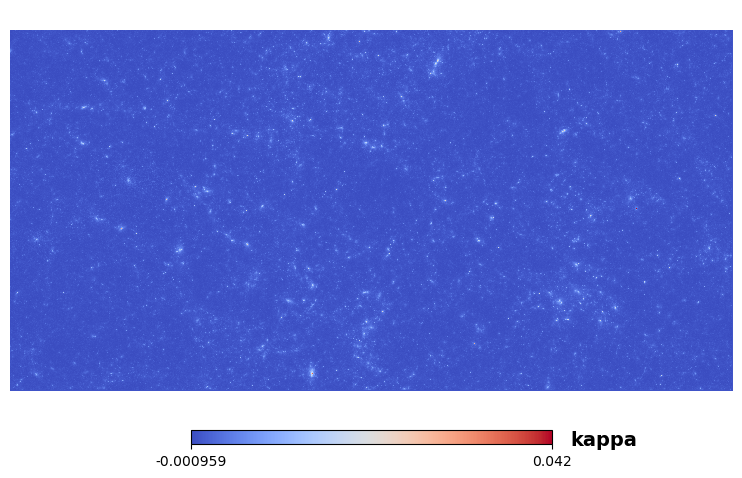

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Mask already defined!


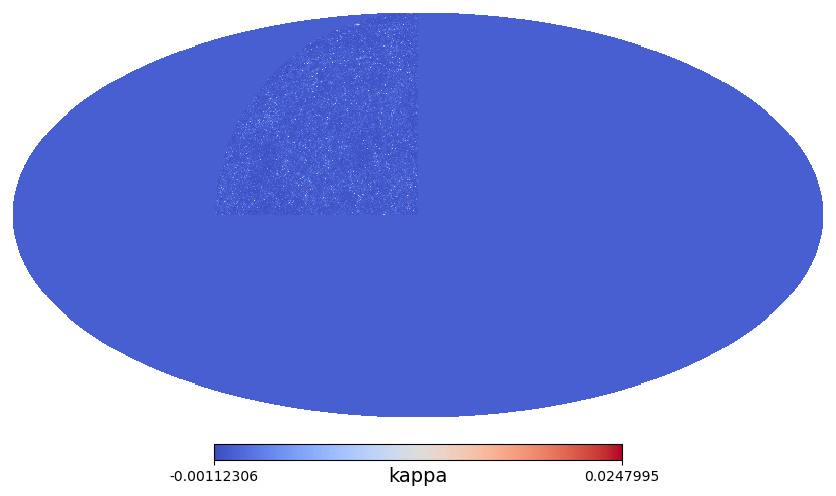

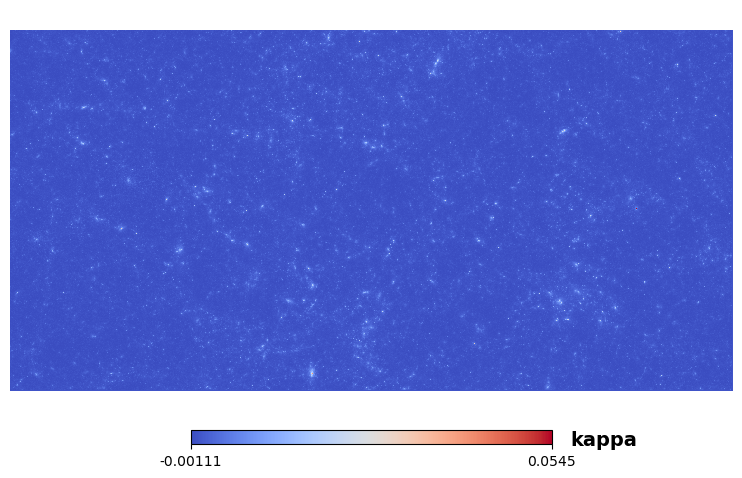

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Mask already defined!


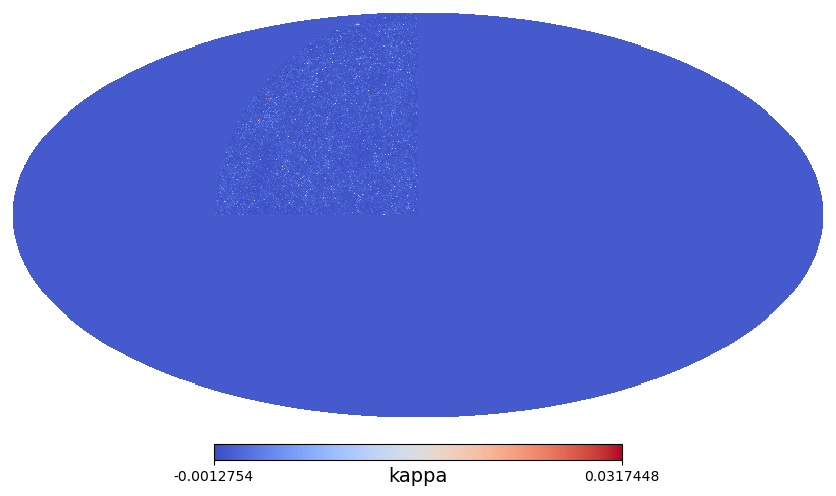

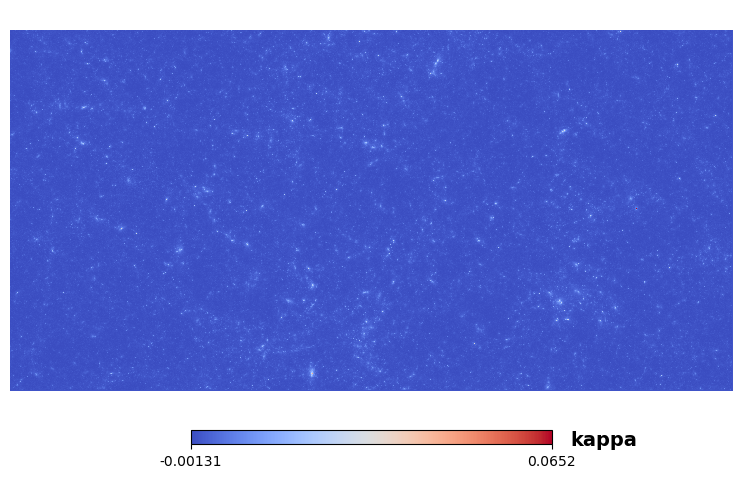

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Mask already defined!


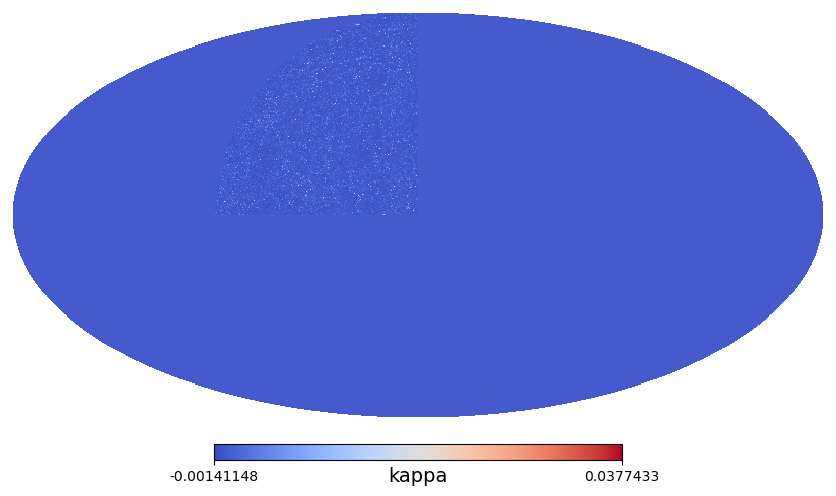

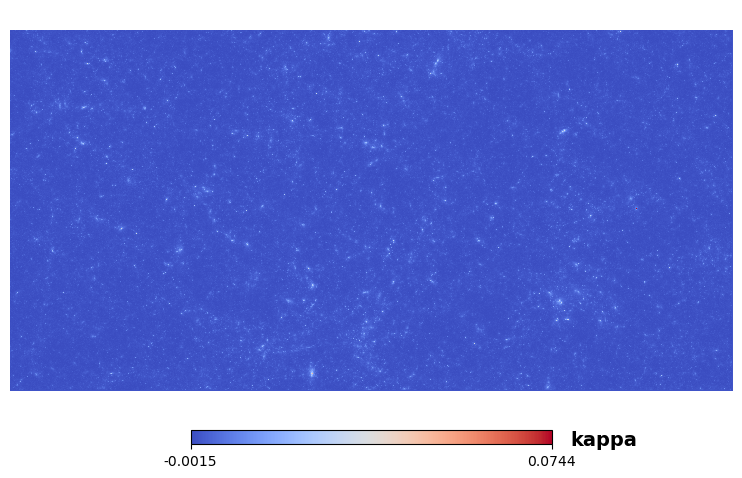

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Mask already defined!


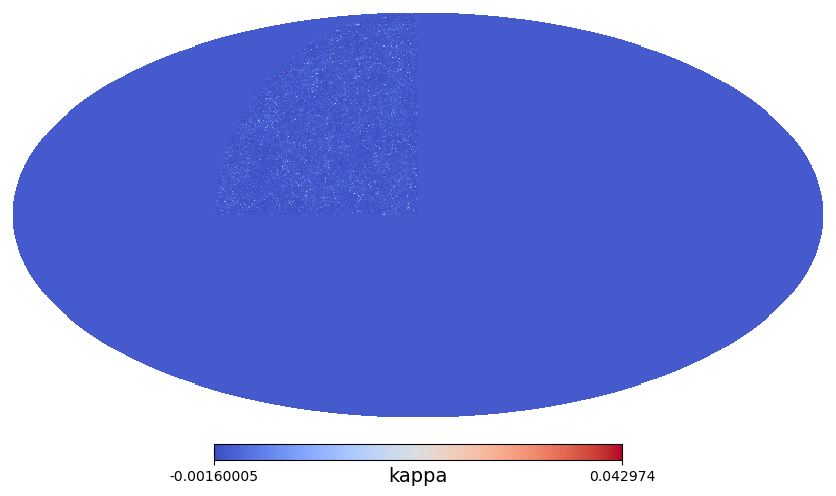

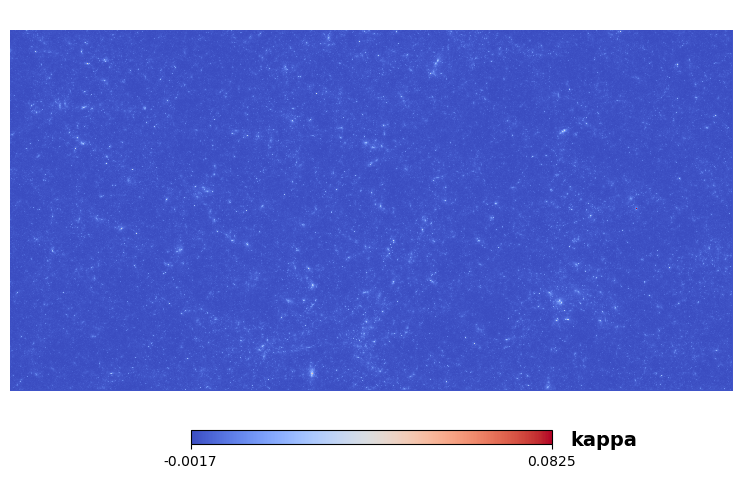

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Mask already defined!


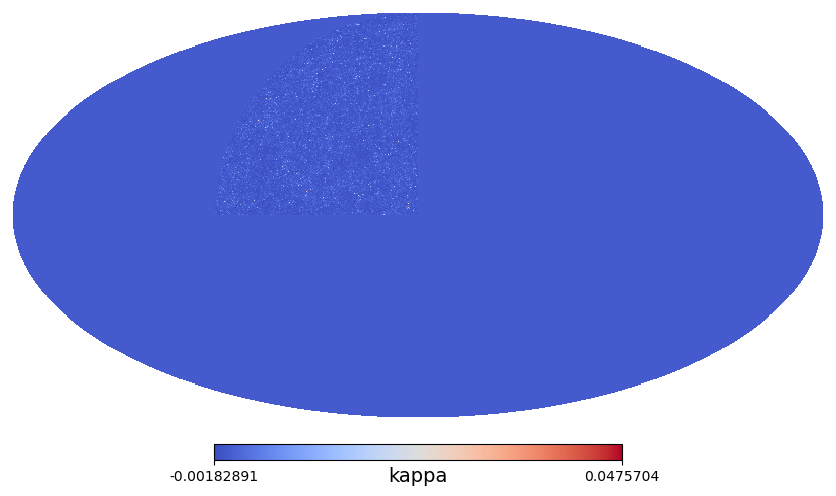

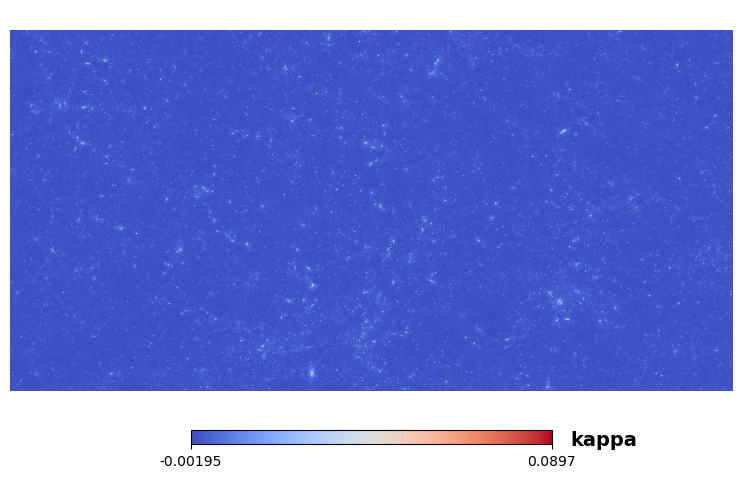

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Mask already defined!


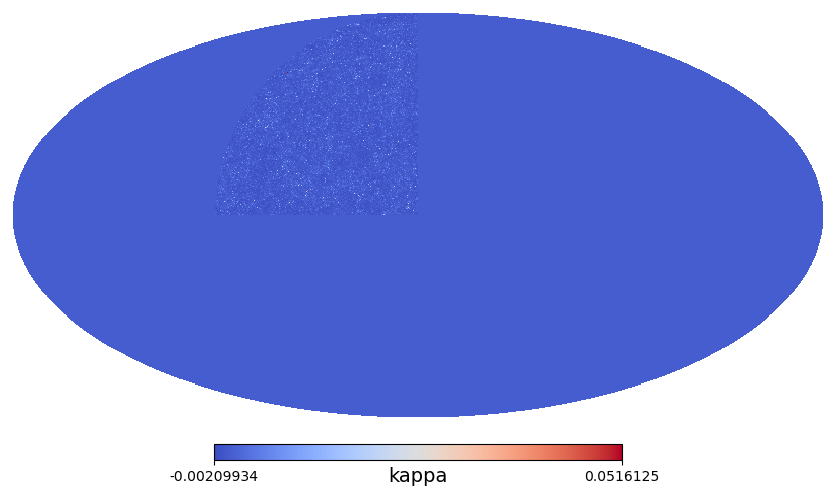

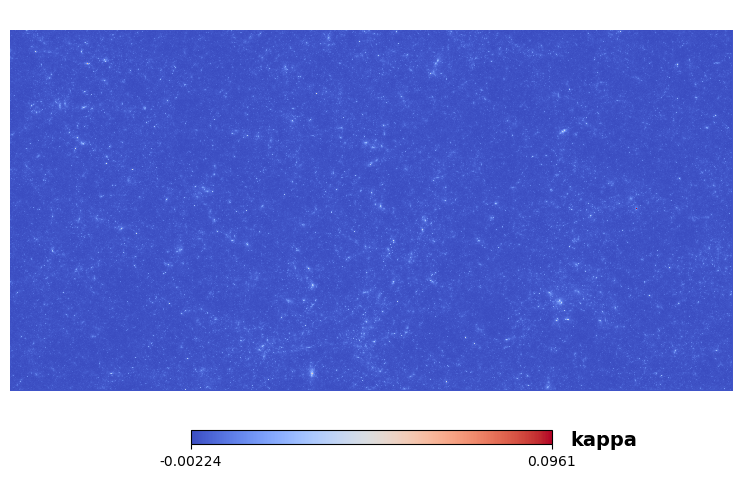

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Mask already defined!


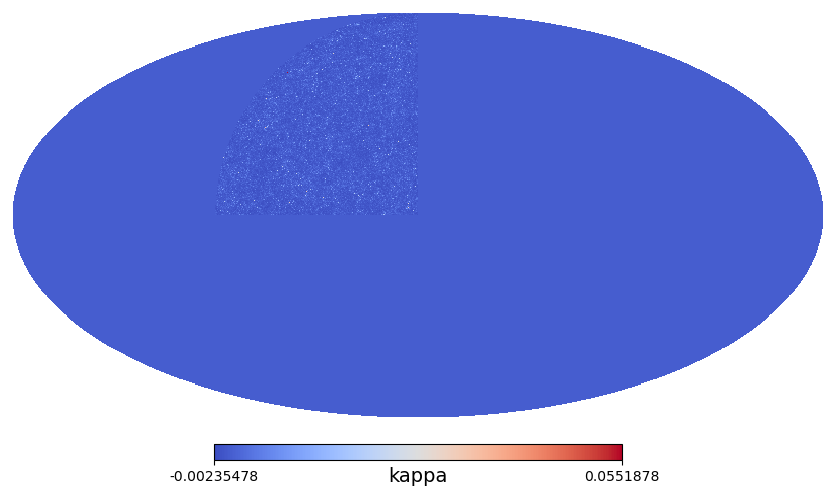

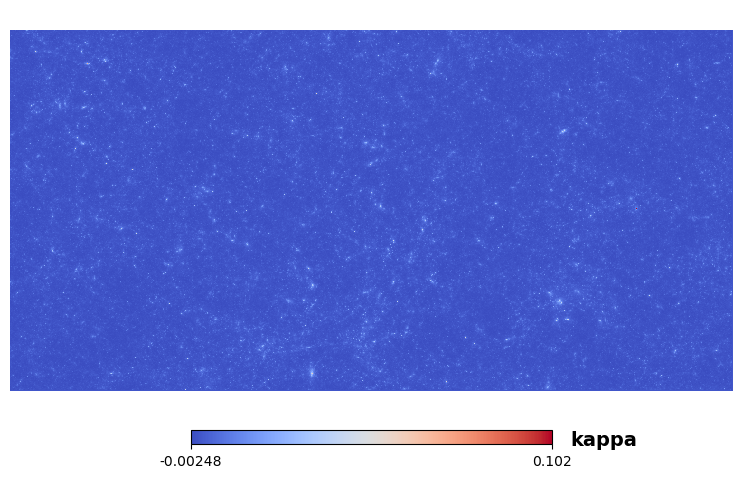

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Mask already defined!


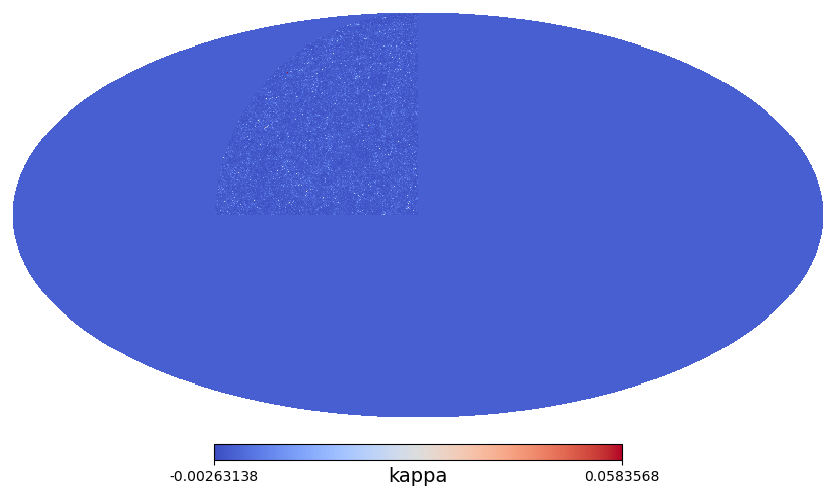

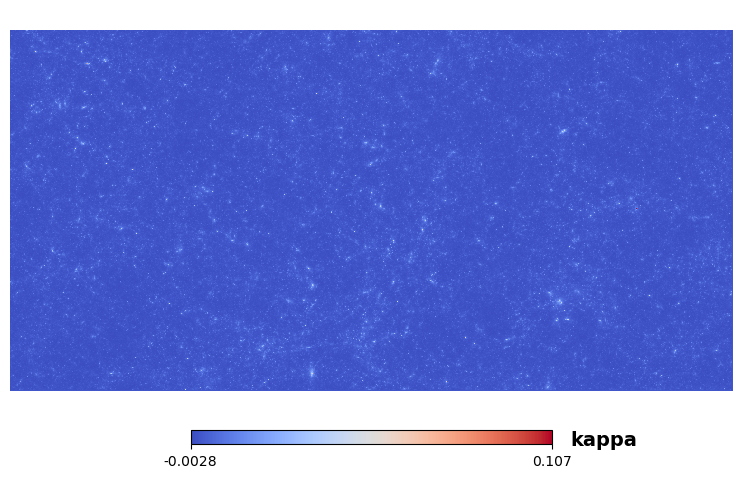

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Mask already defined!


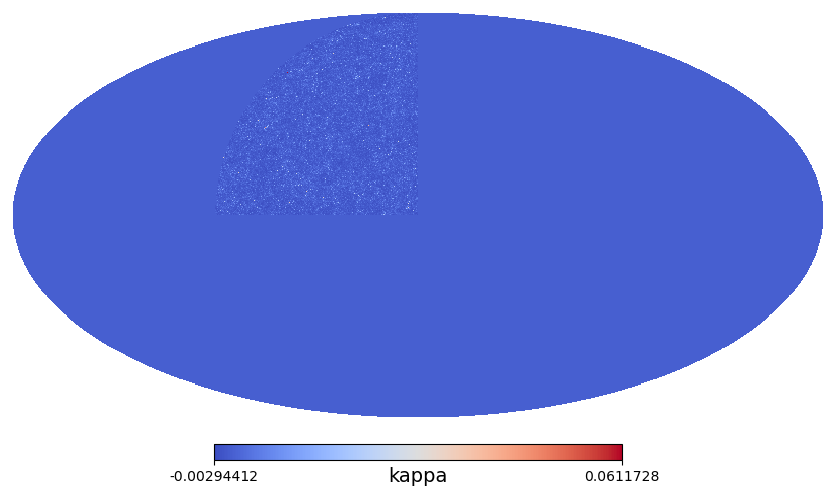

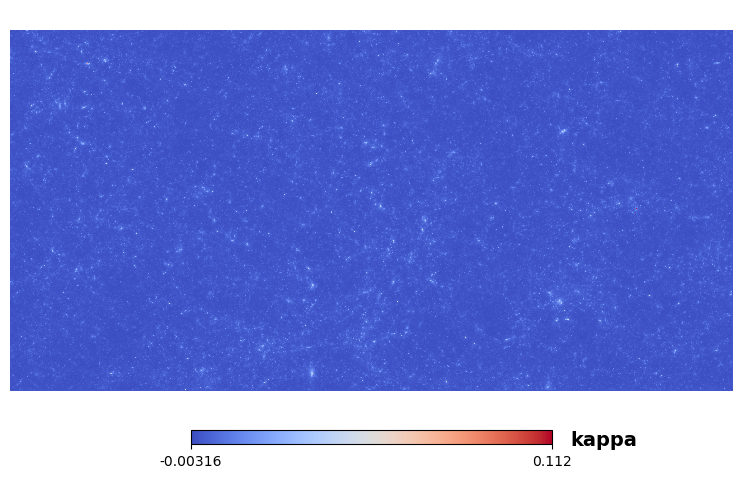

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Mask already defined!


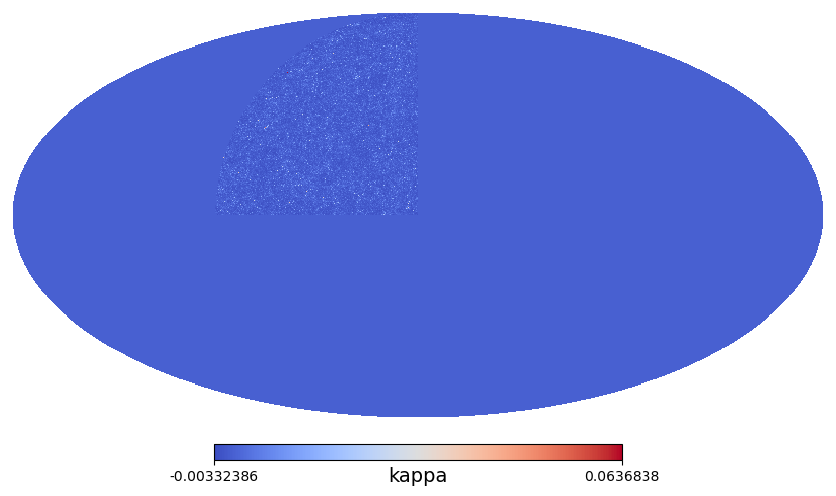

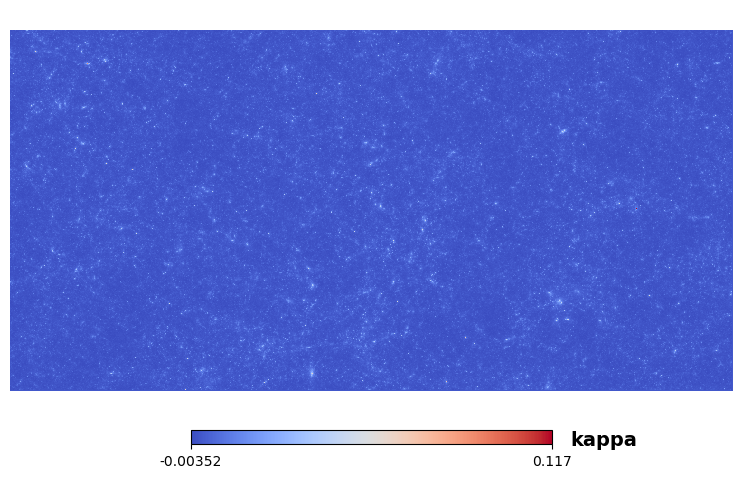

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Mask already defined!


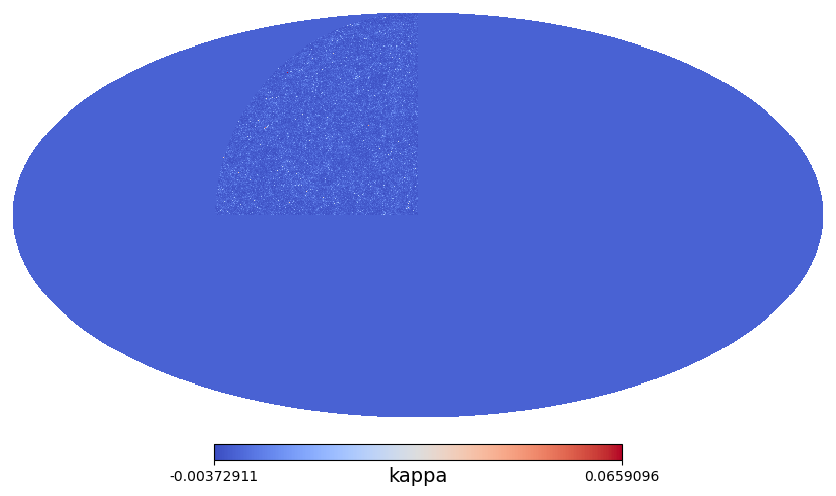

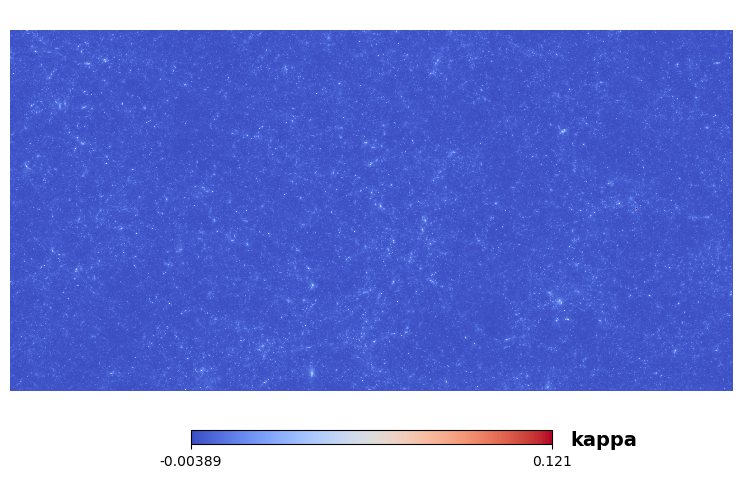

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Mask already defined!


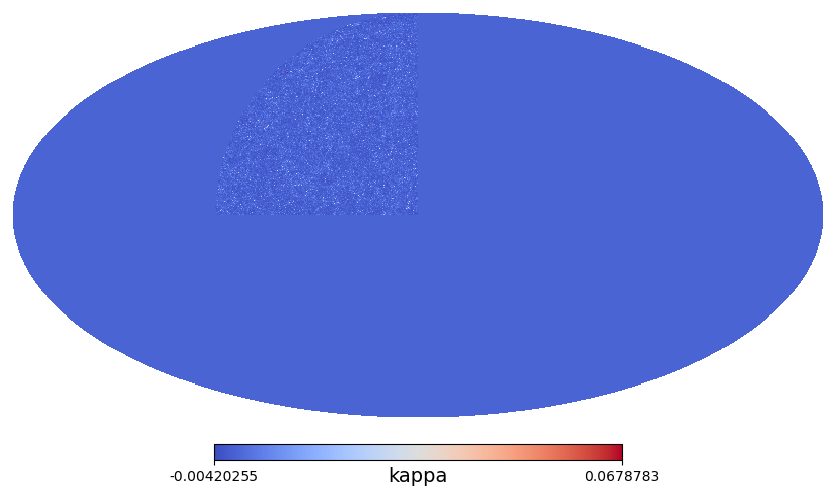

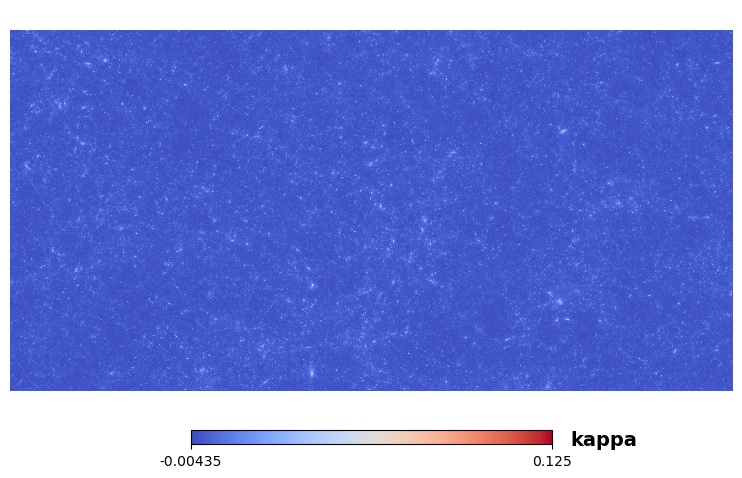

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Mask already defined!


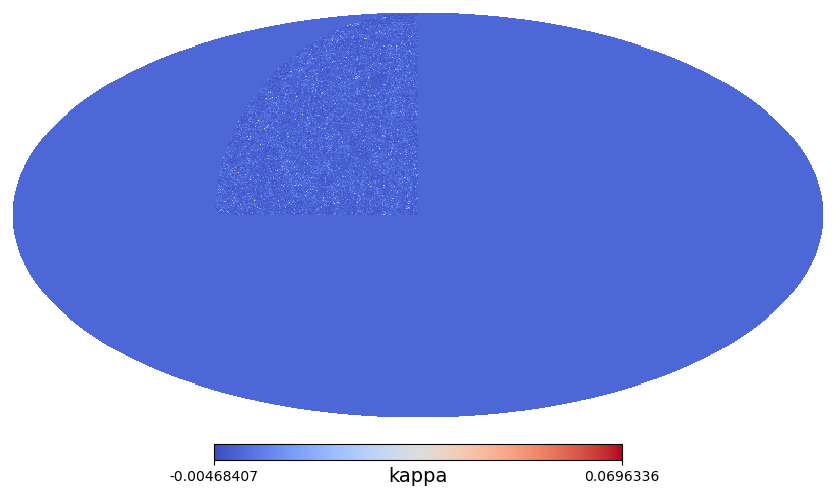

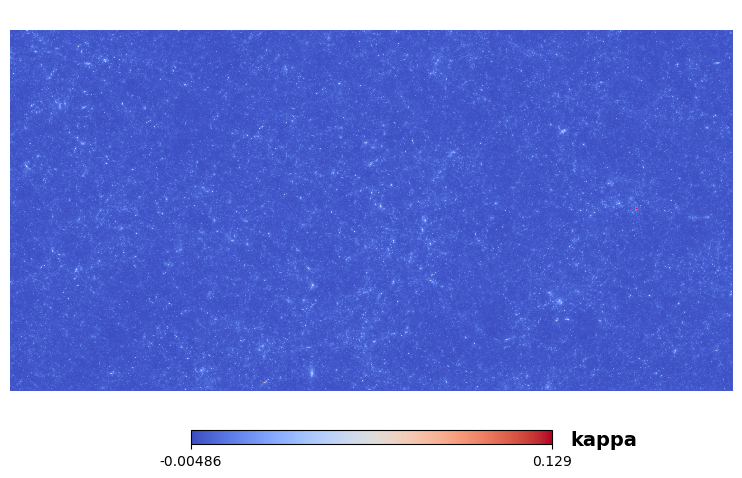

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Mask already defined!


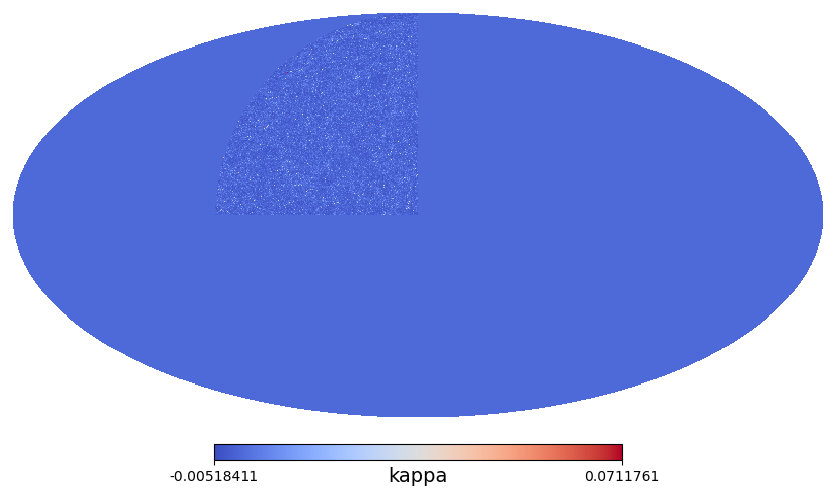

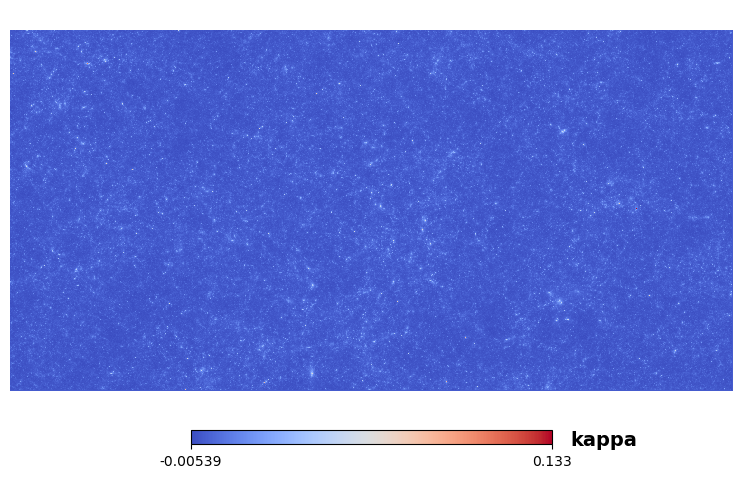

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Mask already defined!


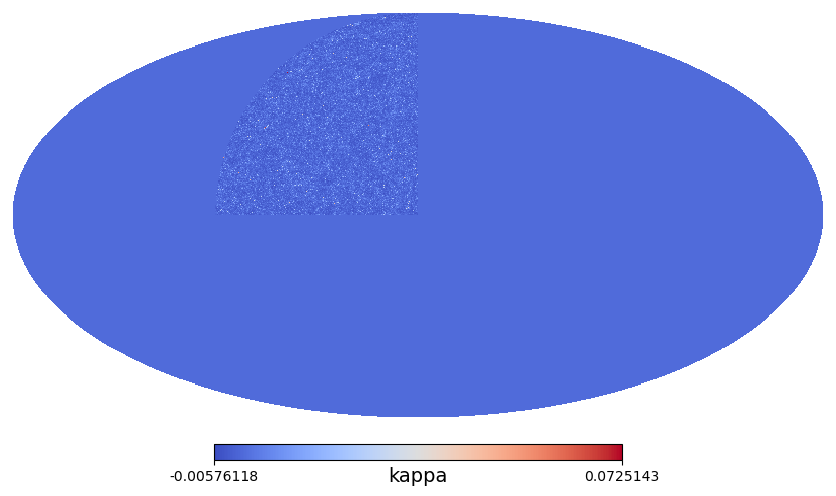

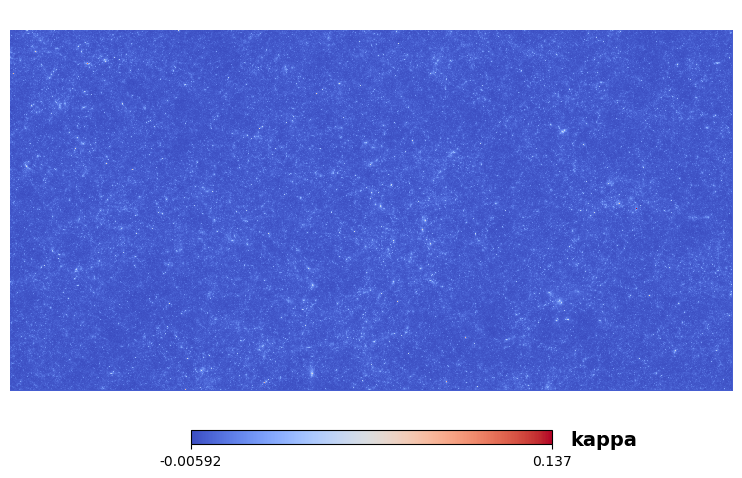

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Mask already defined!


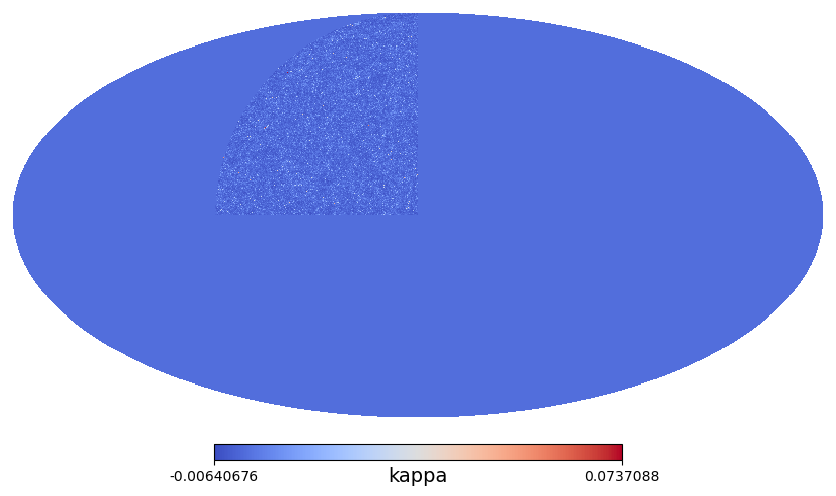

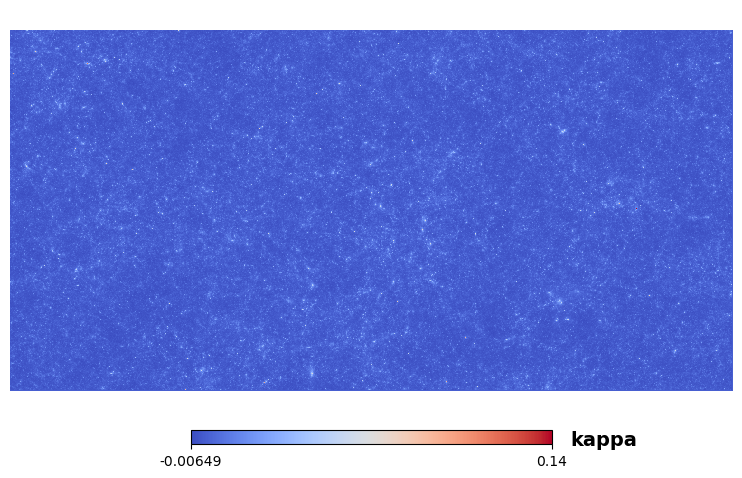

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Mask already defined!


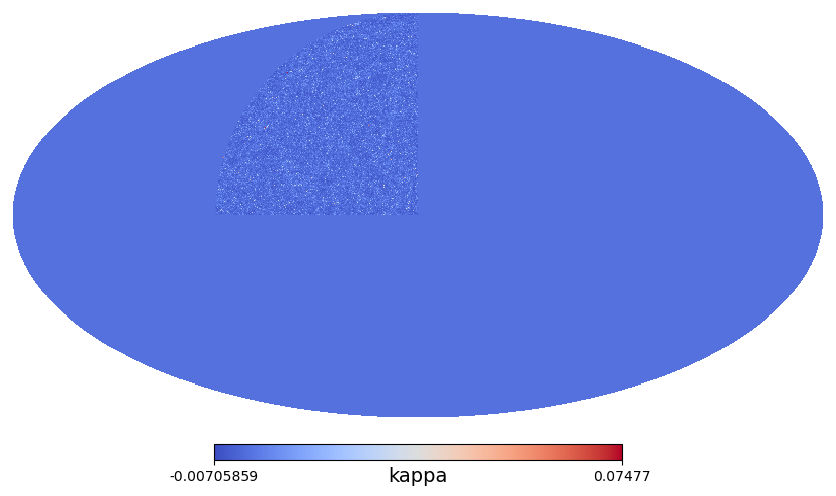

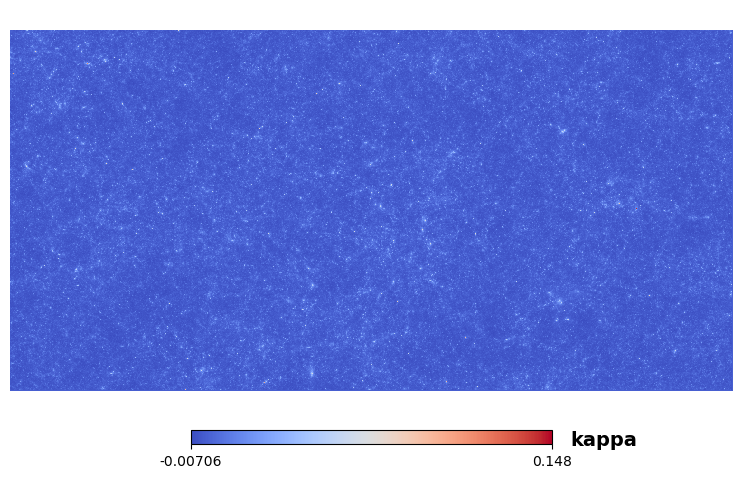

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Mask already defined!


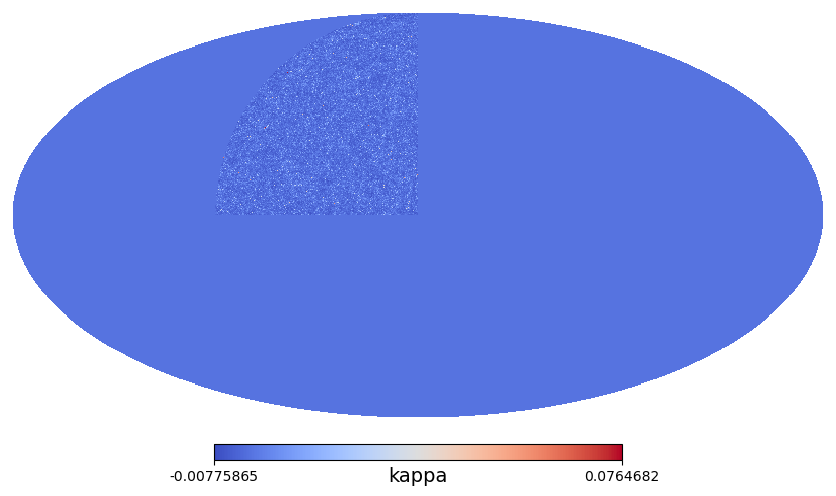

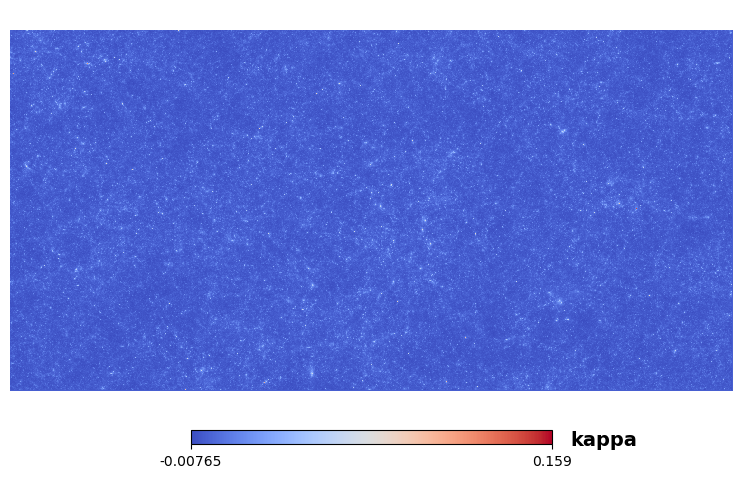

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Mask already defined!


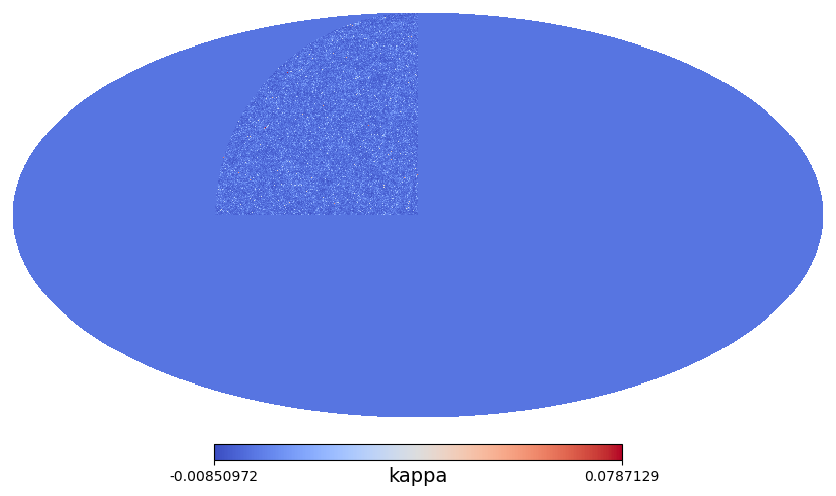

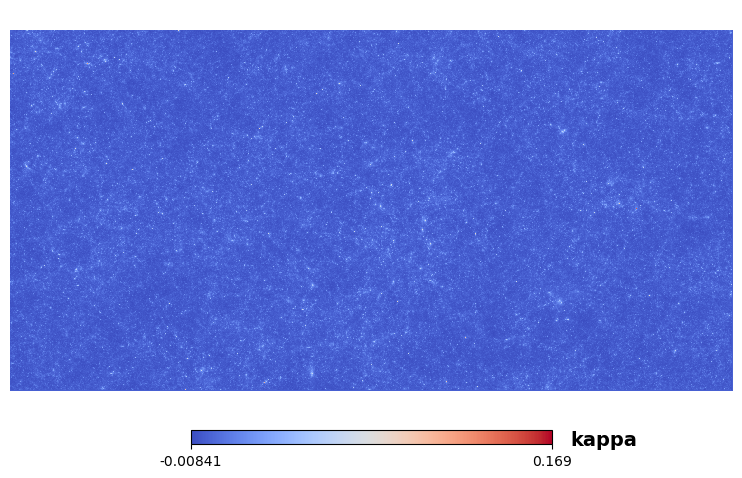

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Got lens 1.038539553752536
Mask already defined!


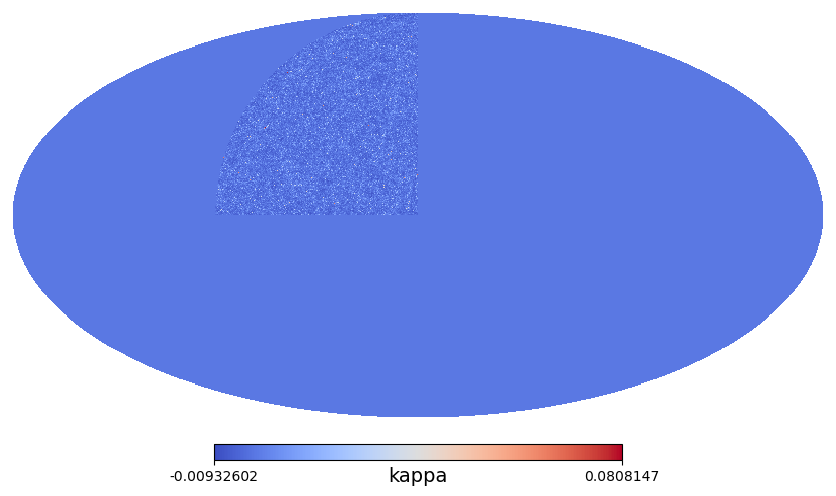

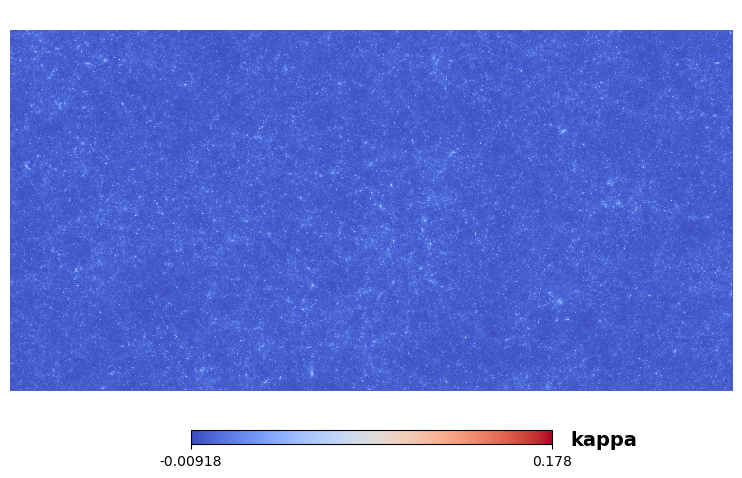

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Got lens 1.038539553752536
Got lens 1.106918238993711
Mask already def

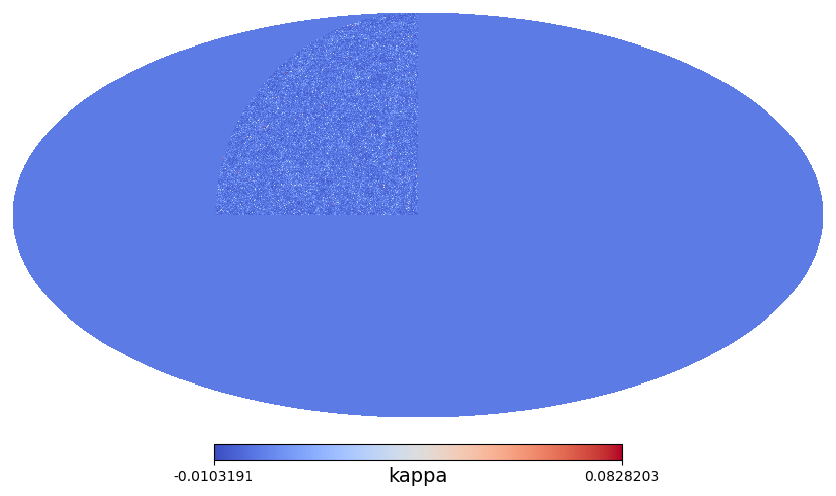

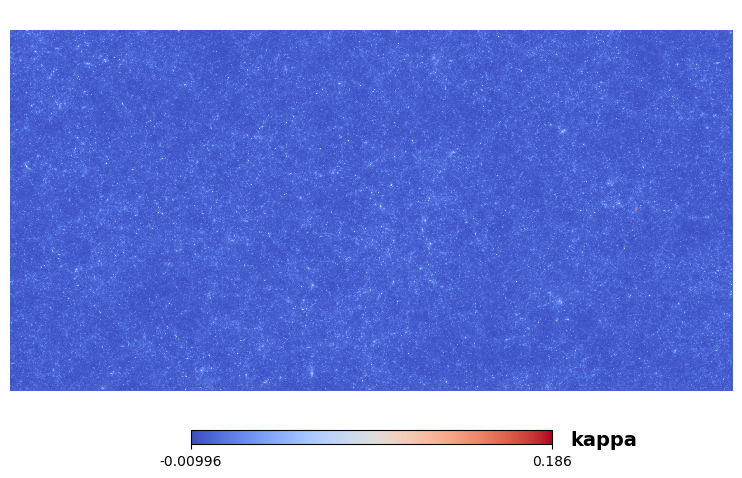

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Got lens 1.038539553752536
Got lens 1.106918238993711
Got lens 1.18004

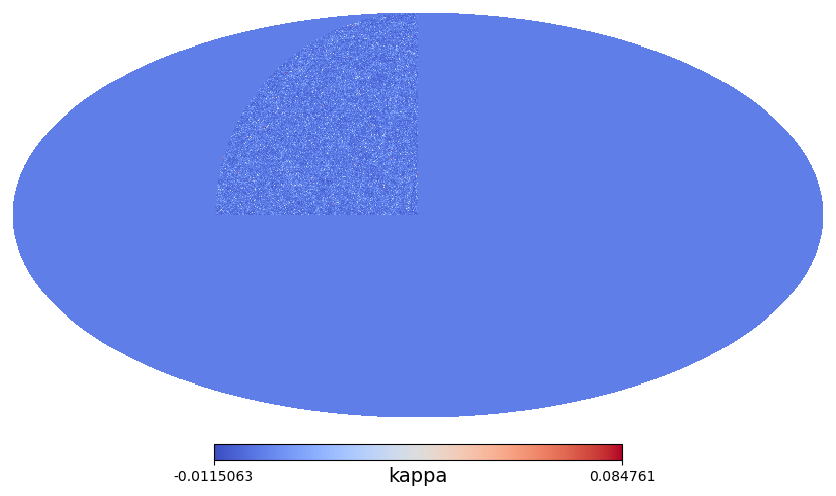

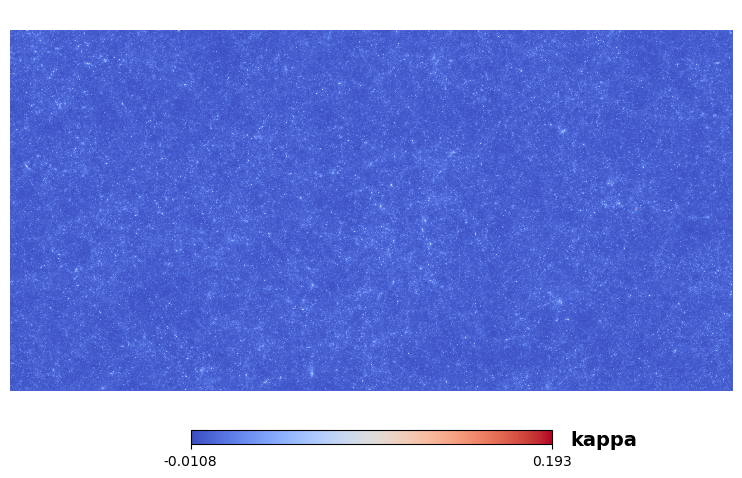

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Got lens 1.038539553752536
Got lens 1.106918238993711
Got lens 1.18004

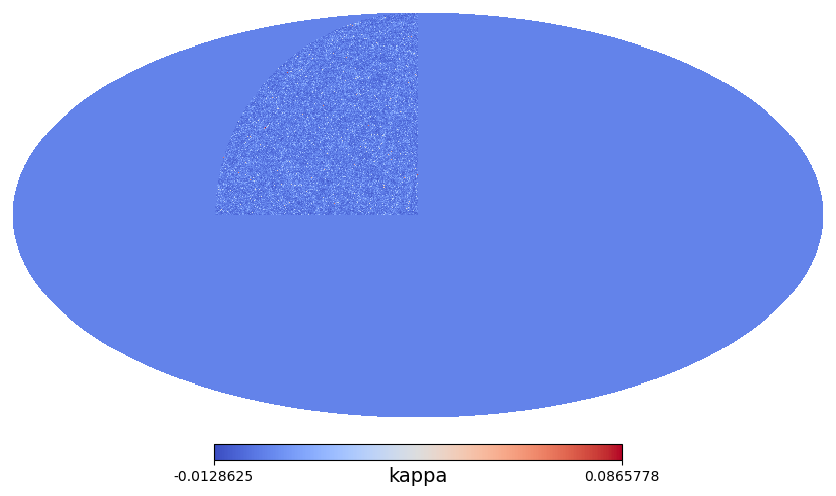

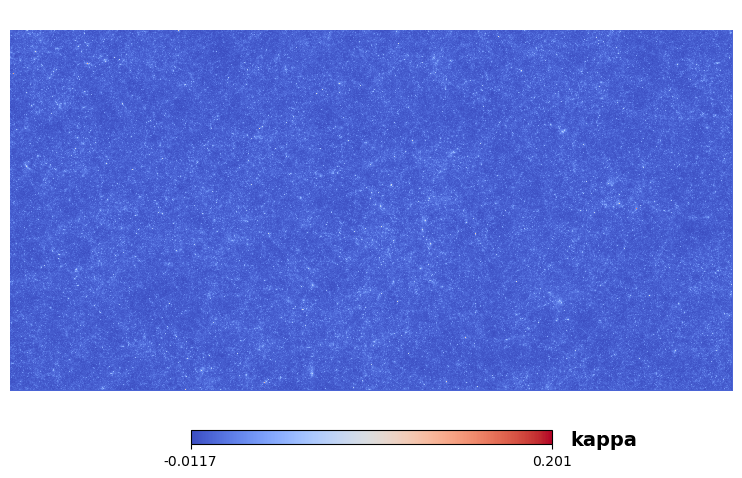

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687
Got lens 0.857670979667283
Got lens 0.9142857142857144
Got lens 0.9744597249508844
Got lens 1.038539553752536
Got lens 1.106918238993711
Got lens 1.18004

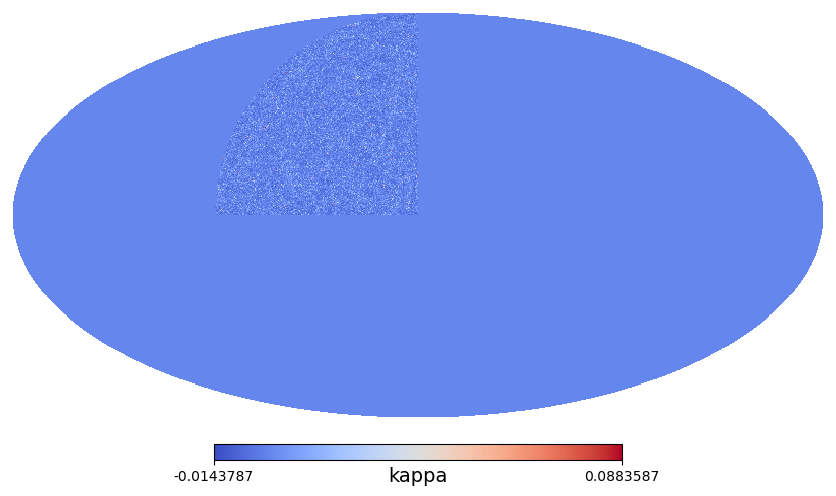

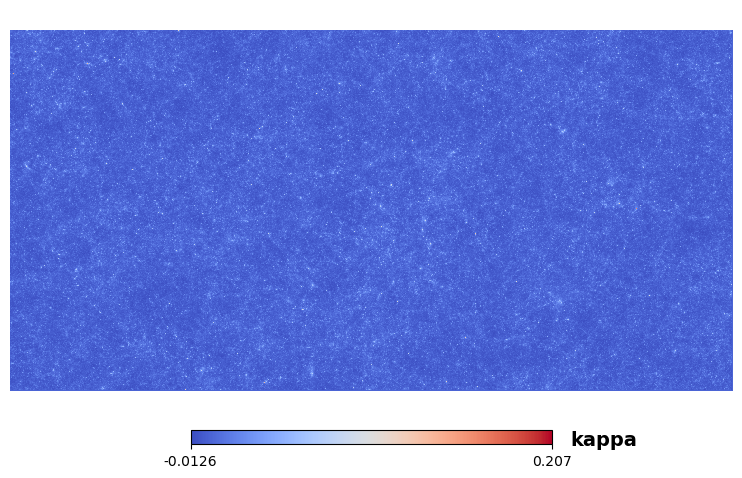

Saved kappa
set minimal zl to 0.005
Got lens 0.0
Got lens 0.016177957532861553
Got lens 0.03288797533401855
Got lens 0.050156739811912265
Got lens 0.0680127523910734
Got lens 0.08648648648648649
Got lens 0.10561056105610578
Got lens 0.12541993281075037
Got lens 0.14595210946408232
Got lens 0.16724738675958184
Got lens 0.18934911242603558
Got lens 0.2123039806996383
Got lens 0.23616236162361637
Got lens 0.26097867001254715
Got lens 0.28681177976952643
Got lens 0.3137254901960784
Got lens 0.341789052069426
Got lens 0.37107776261937264
Got lens 0.4016736401673642
Got lens 0.43366619115549243
Got lens 0.46715328467153316
Got lens 0.5022421524663678
Got lens 0.5390505359877489
Got lens 0.5777080062794349
Got lens 0.6183574879227054
Got lens 0.6611570247933887
Got lens 0.706281833616299
Got lens 0.753926701570681
Got lens 0.8043087971274687


In [ ]:
# Mass2Kappa_zslice
# For n(z) see further below;


#if __name__ == '__main__':
#
nside = 8192
npix = 12 * nside**2
noct = npix / 8 - nside

#FID
#path = '/pscratch/sd/a/avijit97/BCM/HACC/nshells_51/'

#Mc
path = '/pscratch/sd/a/avijit97/BCM/HACC/params_dependencies/full_lightcone/Mc/2.5e13/nshells_51/'

# Start loop over source redshifts

#for zs in zsnap[1:]:
for zs in rds_upper[0:nshells]:



    # Initialise kappa maps:
    kpmap = np.zeros(npix)
    
        
    #planeIndexes = dlup[:,0]<=zs
    #planeIndexes = np.flip(zlens_exact)<=zs
    #print(zs,planeIndexes)
    
    for lens in range(0,nshells):
        zl=zlens_exact[lens]

        if zl >= zs:          
            continue
      
        lens_str = str(lens).zfill(2)
        filename= 'nshells_'+str(nshells)+'_imap_{}/baryonified_shells_v11.h5'.format(lens_str)

        #print(zs, zl)
        #print(filename, lens, zl, zs)
            
        kappa_z = kappa_sl_ss(path+filename, zl, zs, dmo)
        kpmap = kpmap + kappa_z
        print("Got lens " +str(zl))
        #print(kpmap)
    # Convert to ring-ordered for sph.harmonic transforms:
    #kpmap_ring = hp.reorder(kpmap, n2r = True)
    #print("reordered map")

    #Apply mask
    if 'hpmap_weight' in locals():
        print("Mask already defined!")
    else:
        print("Reading in weight map for Mira Titan (Comment if already on disk...)")
        hpmap_weight = hp.fitsfunc.read_map('../..//FullSky_weight.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)
        #hpmap_weight = hp.fitsfunc.read_map('../../FullSky_weight_4096.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)

    # show mask:
    #hp.mollview(hpmap_weight,
    #            unit=None, cmap=pl.cm.coolwarm,
    #            cbar=True, title='weight', norm=None
    #            , nest=False
    #            )
    #pl.show()

    kpmap *= hpmap_weight
    #print("applied mask")

    # show kappa:
    #np.max(kpmap_ring)
    hp.mollview(kpmap[0,:],
                unit='kappa', cmap=pl.cm.coolwarm,
                cbar=True, title='', norm=None
                , nest=False
                )
    pl.show()

    lonra = [0, 20]
    latra = [0, 10]

    hp.cartview(kpmap[0,:],
                cbar=True, lonra=lonra, latra=latra,
                nest=False,
                title=" ",
                # min=-10, max=0,
                cmap=pl.cm.coolwarm,
                norm=None, unit='kappa')
    pl.show()
    
    # save to file:
    if(dmo):
        fname = '../../../BCM/dmo_Mc2.5e13/kappa/'+str('{:5.4f}').format(zs)+'kappa'
        #fname = '../../../BCM/dmo/kappa/'+str('{:5.4f}').format(zs)+'kappa'
    else:
        fname = '../../../BCM/dmb_Mc2.5e13/kappa/'+str('{:5.4f}').format(zs)+'kappa'
        #fname = '../../../BCM/dmb/kappa/'+str('{:5.4f}').format(zs)+'kappa'

    np.save(fname, kpmap)
    print("Saved kappa")

In [ ]:
lens = 2
lens_str = str(lens).zfill(2)
filename = 'nshells_'+str(51)+'_imap_{}/baryonified_shells_v11.h5'.format(lens_str)
with h5py.File(path_in+filename,'r') as f:
    print('h5py file fields:',f.keys())
    nobaryon_shells = np.array(f['nobaryon_shells'])
    

In [ ]:
lonra = [0, 20]
latra = [0, 10]
#hp.cartview(kpmap[0,:],
hp.cartview(nobaryon_shells[0,:],
            cbar=True, lonra=lonra, latra=latra,
            nest=False,
            title=" ",
            # min=-10, max=0,
            cmap=pl.cm.coolwarm,
            norm=None, unit='kappa')
pl.show()


#binwidth = 0.05
#(n1, bins1, patches1) = pl.hist(kpmap, facecolor = 'blue')

#pl.show()



Loading convergence map and computing C_ell's: zs=1.9472

loaded kappa


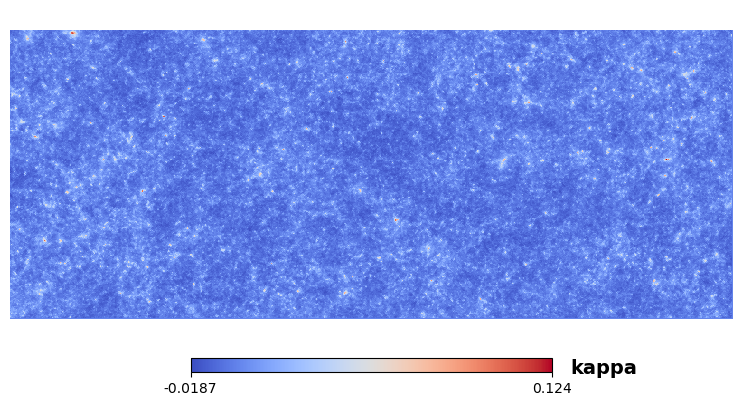

loaded kappa


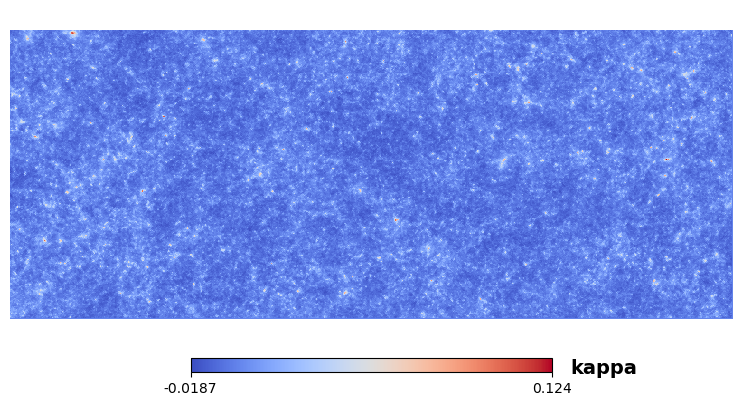

Got C_ell


/tmp/ipykernel_1614383/3564888038.py:52: FutureWarning: In the future `np.str` will be defined as the corresponding NumPy scalar.
  fname = '../../../BCM/dmo/kappa/'+np.str("{:5.4f}".format(zs))+"Cl.dat"


AttributeError: module 'numpy' has no attribute 'str'.
`np.str` was a deprecated alias for the builtin `str`. To avoid this error in existing code, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

In [6]:
# Compute C_ell:
for zs in rds_upper[0:51]:

    print( "\nLoading convergence map and computing C_ell's: zs={:5.4f}\n".format(zs) )
    fname = '../../../BCM/dmo/kappa/'+str('{:5.4f}').format(zs)+"kappa.npy"
    kpmap = np.load(fname)
    print("loaded kappa")

    
    lonra = [0, 5]
    latra = [0, 2]
    hp.cartview(kpmap[0,:],
            cbar=True, lonra=lonra, latra=latra,
            nest=False,
            title=" ",
            # min=-10, max=0,
            cmap=pl.cm.coolwarm,
            norm=None, unit='kappa')
    pl.show()
    #print(np.shape(kpmap))
    #binwidth = 0.05
    #(n1, bins1, patches1) = pl.hist(kpmap, facecolor = 'blue')

    pl.show()

    fname2 = '../../../BCM/dmb/kappa/'+str('{:5.4f}').format(zs)+"kappa.npy"
    kpmap2 = np.load(fname)
    print("loaded kappa")

    
    lonra = [0, 5]
    latra = [0, 2]
    hp.cartview(kpmap2[0,:],
            cbar=True, lonra=lonra, latra=latra,
            nest=False,
            title=" ",
            # min=-10, max=0,
            cmap=pl.cm.coolwarm,
            norm=None, unit='kappa')
    pl.show()
    #print(np.shape(kpmap))
    #binwidth = 0.05
    #(n1, bins1, patches1) = pl.hist(kpmap, facecolor = 'blue')

    pl.show()

    
    # Compute C_ell:
    Cl = hp.sphtfunc.anafast(kpmap, map2=None, nspec=None, lmax=5000, mmax=None, iter=1, alm=False, pol=False, use_weights=False, datapath=None, gal_cut=0, use_pixel_weights=False)
    Cl *= 8.0
    print("Got C_ell")
    fname = '../../../BCM/dmo/kappa/'+str("{:5.4f}".format(zs))+"Cl.dat"
    np.savetxt(fname,Cl)
    print("Saved C_ell dmo")
    
    Cl = hp.sphtfunc.anafast(kpmap2, map2=None, nspec=None, lmax=5000, mmax=None, iter=1, alm=False, pol=False, use_weights=False, datapath=None, gal_cut=0, use_pixel_weights=False)
    Cl *= 8.0
    print("Got C_ell")
    fname = '../../../BCM/dmb/kappa/'+str("{:5.4f}".format(zs))+"Cl.dat"
    np.savetxt(fname,Cl)
    print("Saved C_ell dmb")


In [ ]:
# kappa2shear:

nside = 8192
npix = 12 * nside**2
noct = npix / 8 - nside
seed=1
#IC=150


#for zs in zsnap[0:1]:
#for zs in zsnap[28:29]:
for zs in rds_upper[0:nshells]:
#for zs in rds_upper[0:1]:

    print( "\nLoading convergence map and computing shear maps for zs={:5.4f}\n".format(zs) )
    #fname = '../../../HACC-Y1/kappa/V0/IC'+str(IC)+'/seed'+str(seed)+"/"+np.str("{:5.4f}".format(zs))+"kappa.npy"
    fname = '../../../BCM/dmb_Mc2.5e13/kappa/'+str('{:5.4f}').format(zs)+'kappa.npy'
    #fname = '../../../BCM/dmb/kappa/'+str('{:5.4f}').format(zs)+'kappa.npy'
    kpmap_ring = np.load(fname)
    print("loaded kappa")

    # Compute shear:
    print("starting kappa map2alm")
    #alm_E = hp.sphtfunc.map2alm(kpmap_ring, lmax=5000, mmax=None, iter=3, pol=False, use_weights=False, datapath=None)
    alm_E = hp.sphtfunc.map2alm(kpmap_ring, lmax=8192, mmax=None, iter=3, pol=False, use_weights=False, datapath=None)

    #alm_E = hp.sphtfunc.map2alm(hpmap, lmax=20000, mmax=None, iter=3, pol=False, use_weights=False, datapath=None)
    #alm_E = hp.sphtfunc.map2alm(hpmap_ring, lmax=5000, mmax=None, iter=3, pol=False, use_weights=False, datapath=None)
    #alm_T = alm_E*0.0;
    alm_B = alm_E*0.0;
    #
    print("Starting shear alm2map")
    #maps_QU = hp.alm2map_spin((alm_E, alm_B), nside, spin=2,lmax=5000,mmax=None)
    maps_QU = hp.alm2map_spin((alm_E, alm_B), nside, spin=2,lmax=8192,mmax=None)

    
    #maps_TQU = hp.sphtfunc.alm2map((alm_T, alm_E, alm_B), nside, lmax=32768, mmax=None, pixwin=True, fwhm=0.0, sigma=None, pol=True, inplace=False, verbose=True)
    #maps_TQU = hp.sphtfunc.alm2map((alm_T, alm_E, alm_B), nside, lmax=20000, mmax=None, pixwin=True, fwhm=0.0, sigma=None, pol=True, inplace=False, verbose=True)
    #maps_TQU = hp.sphtfunc.alm2map((alm_T, alm_E, alm_B), nside, lmax=20000, mmax=None, pixwin=False, fwhm=0.0, sigma=None, pol=True, inplace=False, verbose=True)
    #
    gamma1 = maps_QU[0]
    gamma2 = maps_QU[1]
    print("Got shear")
    #fname1 = '../../../BCM/dmb/shear/'+str('{:5.4f}').format(zs)+'gamma1'
    #fname2 = '../../../BCM/dmb/shear/'+str('{:5.4f}').format(zs)+'gamma2'
    fname1 = '../../../BCM/dmb_Mc2.5e13/shear/'+str('{:5.4f}').format(zs)+'gamma1'
    fname2 = '../../../BCM/dmb_Mc2.5e13/shear/'+str('{:5.4f}').format(zs)+'gamma2'

    #fname1 = input.shearDir+np.str("{:5.4f}".format(zs))+"gamma1"
    #fname2 = input.shearDir+np.str("{:5.4f}".format(zs))+"gamma2"
    np.save(fname1, gamma1)
    np.save(fname2, gamma2)
    print("Saved gamma")
    
    # show kappa:
    #np.max(kpmap_ring)
    #hp.mollview(kpmap_ring,
    #            unit='kappa', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()

    #lonra = [0, 20]
    #latra = [0, 10]

    #hp.cartview(kpmap_ring,
    #            cbar=True, lonra=lonra, latra=latra,
    #            nest=False,
    #            title=" ",
    #            # min=-10, max=0,
    #            cmap=pl.cm.coolwarm,
    #            norm=None, unit='kappa')
    #pl.show()
    #
    # show gamma1:
    #np.max(kpmap_ring)
    #hp.mollview(gamma1,
    #            unit='gamma1', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()

    #hp.cartview(gamma1,
    #            cbar=True, lonra=lonra, latra=latra,
    #            nest=False,
    #            title=" ",
    #            # min=-10, max=0,
    #            cmap=pl.cm.coolwarm,
    #            norm=None, unit='shear1')
    #pl.show()
    # show kappa:
    #np.max(kpmap_ring)
    #hp.mollview(gamma2,
    #            unit='gamma2', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()

    #lonra = [0, 20]
    #latra = [0, 10]

    #hp.cartview(gamma2,
    #            cbar=True, lonra=lonra, latra=latra,
    #            nest=False,
     #           title=" ",
    #            # min=-10, max=0,
     #           cmap=pl.cm.coolwarm,
      #          norm=None, unit='shear2')
    #pl.show()


Loading convergence map and computing shear maps for zs=0.0080

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.0245

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.0415

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.0590

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.0772

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.0960

loaded kappa
starting kappa map2alm
Starting shear alm2map
Got shear
Saved gamma

Loading convergence map and computing shear maps for zs=0.1154

loaded kappa
starting kappa map2alm
Starting shear alm2map


In [ ]:
# Mass2Kappa_n(z)
nside = 4096
npix = 12 * nside**2
noct = npix / 8 - nside

#nshells=19
seed=0
IC=150
path = '/global/cscratch1/sd/xuod/HOS_sims/L845/HACC'+str(IC)+'/'


#input_dir = input.baseDirectory
#mapsNames = sorted(directory_contents)[58:1:-1] # use this one when there is a README file in the directory.
#mapsNames = sorted(directory_contents)[57:0:-1]

#mapsNames = np.array(mapsNames)
#print("Found these maps in the directory:", mapsNames)
#print("Found a total of ",np.shape(mapsNames), "Maps")
#print("*****")


# Start loop over source redshifts

for tomo in range(1,6):
    
    print("Working on tomo", tomo)
    # Initialise kappa maps:
    kpmap = np.zeros(npix)
    zid=0

    for lens in range(0,nshells):
        zl=zlens_exact[zid]
        
        filename= 'shells_z'+str(nshells)+'_subsampleauto_groupiso/shell_hacc_z'+str(lens)+'_nside4096_seed'+str(seed)+'.fits'
        print(filename, lens, zl, zid)

        kappa_z = kappa_sl_ms(path+filename,"./Euclid_dndz_fu08_bin1-5.dat",zl,tomo)
        kpmap = kpmap + kappa_z
        print("Got lens " +str(zl))
        print(kappa_z)
        zid+=1
        #hp.cartview(kpmap,
        #        cbar=True, lonra=lonra, latra=latra,
        #        nest=False,
        #        title=" ",
        #        # min=-10, max=0,
        #        cmap=pl.cm.coolwarm,
        #        norm=None, unit='kappa')
        #pl.show()

    #Map already in ring format, no need to re-order

    #Apply mask
    if 'hpmap_weight' in locals():
        print("Mask already defined!")
    else:
        print("Reading in weight map for Mira Titan (Comment if already on disk...)")
        #hpmap_weight = hp.fitsfunc.read_map('../../FullSky_weight.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)
        hpmap_weight = hp.fitsfunc.read_map('../../FullSky_weight_4096.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)

    # show mask:
    #hp.mollview(hpmap_weight,
    #            unit=None, cmap=pl.cm.coolwarm,
    #            cbar=True, title='weight', norm=None
    #            , nest=False
    #            )
    #pl.show()

    kpmap *= hpmap_weight
    print("applied mask")

    # show kappa:
    #np.max(kpmap_ring)
    #hp.mollview(kpmap,
    #            unit='kappa', cmap=pl.cm.coolwarm,
    #            cbar=True, title='', norm=None
    #            , nest=False
    #            )
    #pl.show()

    #lonra = [0, 20]
    #latra = [0, 10]

    #hp.cartview(kpmap,
    #            cbar=True, lonra=lonra, latra=latra,
    #            nest=False,
    #            title=" ",
    #            # min=-10, max=0,
    #            cmap=pl.cm.coolwarm,
    #            norm=None, unit='kappa')
    #pl.show()
    
    # save to file, in .npy format:
    #fname = input.kappaDir+"kappa_tomo"+np.str(tomo)
    fname = "../../../HACC-Y1/kappa/V0/IC"+str(IC)+"/seed"+str(seed)+"/kappa_tomo"+np.str(tomo)+"_"+np.str(nshells)

    np.save(fname, kpmap)
    print("Saved kappa")


In [ ]:
# Compute C_ell:
for tomo in range(1,6):

    print( "\nLoading convergence map and computing C_ell's: tomo="+np.str(tomo))
    fname = "../../../HACC-Y1/kappa/V0/IC"+str(IC)+"/seed"+str(seed)+"/kappa_tomo"+np.str(tomo)+"_"+str(nshells)+".npy"
    kpmap_ring = np.load(fname)
    print("loaded kappa")

    # Compute C_ell:
    Cl = hp.sphtfunc.anafast(kpmap_ring, map2=None, nspec=None, lmax=5000, mmax=None, iter=1, alm=False, pol=False, use_weights=False, datapath=None, gal_cut=0, use_pixel_weights=False)
    Cl *= 8.0
    print("Got C_ell")
    fname = "../../../HACC-Y1/kappa/V0/IC"+str(IC)+"/seed"+str(seed)+"/Cl_tomo"+np.str(tomo)+"_"+str(nshells)+".dat"
    np.savetxt(fname,Cl)
    print("Saved C_ell")
    


In [ ]:
#hpmap_weight = hp.fitsfunc.read_map('../../FullSky_weight.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)

#show mask:
#hp.mollview(hpmap_weight,
#            unit=None, cmap=pl.cm.coolwarm,
#            cbar=True, title='weight', norm=None
#            , nest=False
#            )
#pl.show()
#print(hpmap_weight)

#hp.mollview(kpmap,
#            unit='kappa', cmap=pl.cm.coolwarm,
#            cbar=True, title='', norm=None
#            , nest=False
#            )
#pl.show()
#print(kpmap)


hp.cartview(kpmap_ring,
            cbar=True, lonra=lonra, latra=latra,
            nest=False,
            title=" ",
            # min=-10, max=0,
            cmap=pl.cm.coolwarm,
            norm=None, unit='kappa')
pl.show()
print(kpmap_ring)


In [ ]:
#Construct mask with correct NSIDE & quadrant:
#a = healsparse.HealSparseMap.read(os.path.join(path, filename))
#mask = a.generate_healpix_map()

# turn masked pixels to zero.
#mask[mask>-1.0e+30]=1
#mask[mask<-1.0e+30]=0

#hp.mollview(mask,
#            unit=None, cmap=pl.cm.coolwarm,
#            cbar=True, title='weight', norm=None
#            , nest=False
#            )
#pl.show()
#hp.fitsfunc.write_map('../../FullSky_weight_4096.fits',mask,nest=False,overwrite=True)


In [ ]:
#del hpmap_weight

In [ ]:
# Mass2Kappa_n(z) using SimulLens code:
nside = 8192
npix = 12 * nside**2
noct = npix / 8 - nside
zs=57

input_dir = input.baseDirectory
mapsNames = sorted(directory_contents)[58:1:-1] # use this one when there is a README file in the directory.
#mapsNames = sorted(directory_contents)[57:0:-1]

mapsNames = np.array(mapsNames)
#print("Found these maps in the directory:", mapsNames)
#print("For a total of ",np.shape(mapsNames), "Maps")
#print("*****")
nl = np.shape(mapsNames)[0]
Norm = 1.0

for tomo in range(1,6):

    print('*** Working on tomo' , tomo, '***')
    
    #----
    # Read the n(z) files
    zs,Nz = np.loadtxt("./Euclid_dndz_fu08_bin1-5.dat",comments='#',usecols=(0,tomo),unpack=True)
    #Nz_normal = Nz/total_area(zs,Nz)
    nzbins = np.shape(zs)[0]

    #----
    # compute the Jacobian, dchi/dz:
    chi_file = np.zeros(nzbins)
    for i in range(0,nzbins):
        chi_file[i] = ncosmo.comoving_distance(zs[i]).value*ncosmo.h
        #print(i,zs[i], chi_file[i])

    #----
    # compute the dchi:
    dchi = np.zeros(nzbins)
    for i in range(0,nzbins-1):
        dchi[i] = chi_file[i+1]-chi_file[i]

    dchi[nzbins-1] = dchi[nzbins-2]


    # Initialise kappa maps:
    kpmap = np.zeros(npix)

    #Loop over the lenses:
    zid=0
    for filename in mapsNames:
        #tmp = filename.split('_')
        #zid = int(tmp[4][:-4])
        #zl = zl_list[zid]
        #zl=dllen[zid, 0]
        #zl=zlens_exact[28-zid]
        zl=zlens_exact[56-zid]
        chi_l = ncosmo.comoving_distance(zl).value*ncosmo.h

        zid+=1

        #find minimum for the Nz integration
        zmin = 0
        for ii in range(0,nzbins):
            if(zs[ii] > zl):
                zmin = ii
                break

        # Get integal over sources
        gw = 0
        for ii in range(zmin, nzbins):
            gw = gw + Nz[ii]*(1.0 - chi_l/chi_file[ii])*dchi[ii]     


        #-----
        # Get Kernel
        kernel = 3./2. * Om0 * (3000/10240)/(3e3**2)*chi_l * (1+zl) * gw * Norm
        #print('Kernel4 = ', kernel)

        #print(zl, zmin, zs[zmin], Nz[zmin], gw, kernel, filename)

        # Get particle_count planes:
        massmap = np.fromfile(input.baseDirectory+filename, dtype="<f")
        
        #Convert to mass planes, in M_sun/h
        #massmap *= mp 

        #Convert to overdensity maps, 
        massmap-=np.mean(massmap)*8

        # Integrate:
        #kpmap = kpmap + massmap*kernel

    continue    
        
    # Convert to ring-ordered for sph.harmonic transforms:
    kpmap_ring = hp.reorder(kpmap, n2r = True)
    print("reordered map")

    #Apply mask
    if 'hpmap_weight' in locals():
        print("Mask already defined!")
    else:
        print("Reading in weight map for Mira Titan (Comment if already on disk...)")
        hpmap_weight = hp.fitsfunc.read_map('../../FullSky_weight.fits', field=0,nest=False, partial=False, hdu=1, h=False, verbose=True, memmap=True)


    kpmap_ring *= hpmap_weight
    print("applied mask")

    
    # show kappa:
    hp.mollview(kpmap_ring,
                unit='kappa', cmap=pl.cm.coolwarm,
                cbar=True, title='', norm=None
                , nest=False
                )
    pl.show()

    lonra = [0, 20]
    latra = [0, 10]

    hp.cartview(kpmap_ring,
                cbar=True, lonra=lonra, latra=latra,
                nest=False,
                title=" ",
                # min=-10, max=0,
                cmap=pl.cm.coolwarm,
                norm=None, unit='kappa')
    pl.show()
    
    
    fname = "../../kappa/V0/kappa_tomo"+np.str(tomo)+"_V3" 

    np.save(fname, kpmap_ring)
    print("Saved kappa")




In [ ]:
# Compute C_ell:
Cl = hp.sphtfunc.anafast(kpmap_ring, map2=None, nspec=None, lmax=5000, mmax=None, iter=1, alm=False, pol=False, use_weights=False, datapath=None, gal_cut=0, use_pixel_weights=False)
Cl *= 8.0
print("Got C_ell")
#fname = "../../kappa/V0/Cl_tomo"+np.str(tomo)+".dat"
fname = "../../kappa/V0/Cl_tomo"+np.str(tomo)+"_V3.dat"
np.savetxt(fname,Cl)
print("Saved C_ell")



In [ ]:
input_dir = input.baseDirectory
mapsNames = sorted(directory_contents)[58:1:-1] # use this one when there is a README file in the directory.
#mapsNames = sorted(directory_contents)[57:0:-1]

mapsNames = np.array(mapsNames)

zid=0
for filename in mapsNames:
    #tmp = filename.split('_')
    #zid = int(tmp[4][:-4])
    #zl = zl_list[zid]
    #zl=dllen[zid, 0]
    #zl=zlens_exact[28-zid]
    zl=zlens_exact[56-zid]
    chi_l = ncosmo.comoving_distance(zl).value*ncosmo.h

    zid+=1

    #find minimum for the Nz integration
    zmin = 0
    for ii in range(0,nzbins):
        if(zs[ii] > zl):
            zmin = ii
            break

    # Get integal over sources
    gw = 0
    for ii in range(zmin, nzbins):
        gw = gw + Nz[ii]*(1.0 - chi_l/chi_file[ii])*dchi[ii]     

    print(zl, zmin, zs[zmin], Nz[zmin], gw)


In [ ]:

print(filename)